# Traffic Light Frozen Inference Model Tests

### Simulator and Real Track Test Images

Tests of traffic light detection/localization/classification on Udacity simulator images as well as Udacity real track images. 

# Imports

In [1]:
import numpy as np
import os
import sys
import tensorflow as tf

from collections import defaultdict
from io import StringIO
from matplotlib import pyplot as plt
from PIL import Image

import time

# Tested with tensorflow 1.3


In [2]:
# This is needed to display the images withing the notbook.
%matplotlib inline

## Object detection imports
Here are the imports from the object detection module.

In [3]:
from utils import label_map_util

from utils import visualization_utils as vis_util

## Helper code

In [4]:
def load_image_into_numpy_array(image):
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

## Loading label map
Label maps map indices to category names, so that when our convolution network predicts `1`, we know that this corresponds to `Green`, 2 to `Red`, and 3 to `Yellow`.

In [5]:
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = 'tl_label_map.pbtxt'

NUM_CLASSES = 3

label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

# Model preparation for trial23_rfcn_resnet_real_20000_frozen_inference_graph

In [6]:
# What model to download.

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = os.path.join('models', 'trial23_rfcn_resnet_real_20000_frozen_inference_graph.pb')

### Load a (frozen) Tensorflow model into memory.

In [7]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

## trial23_rfcn_resnet_real_20000_frozen_inference_graph
## Detection on Real Images

In [8]:
from glob import glob
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = 'test_images_real'
TEST_IMAGE_PATHS = glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.jpg'))

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

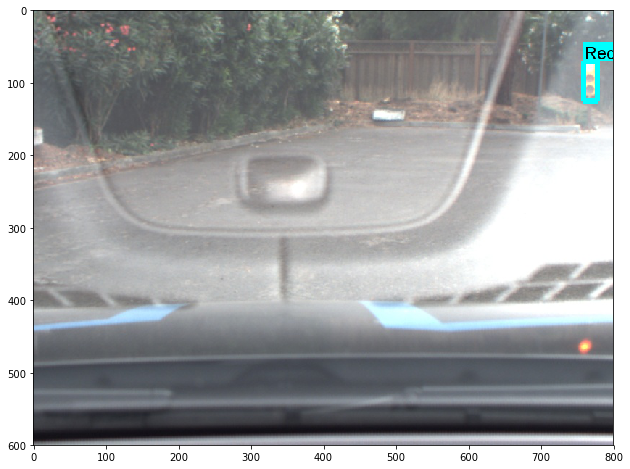

Time in ms:  4569.215536117554 



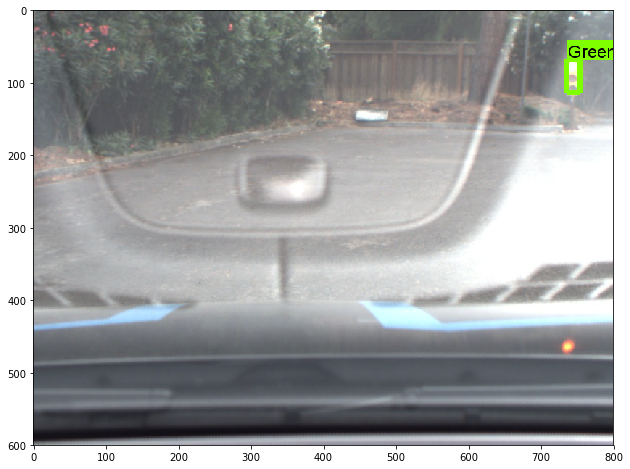

Time in ms:  80.71684837341309 



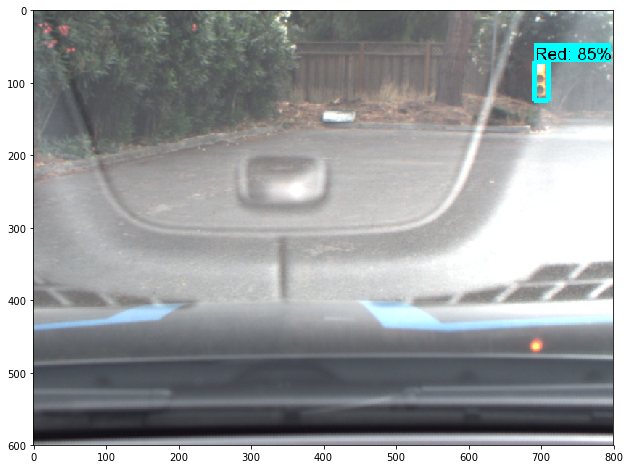

Time in ms:  81.21705055236816 



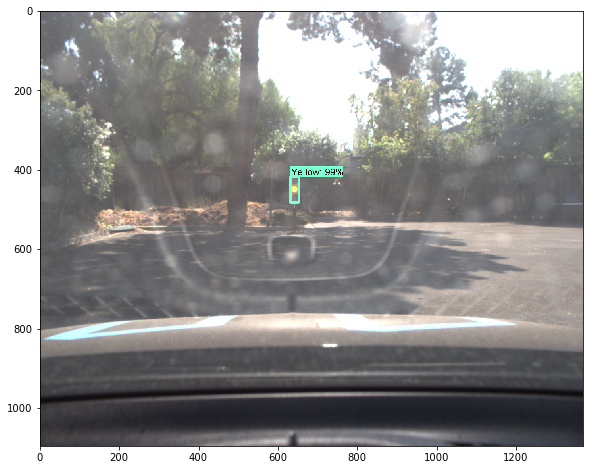

Time in ms:  83.72378349304199 



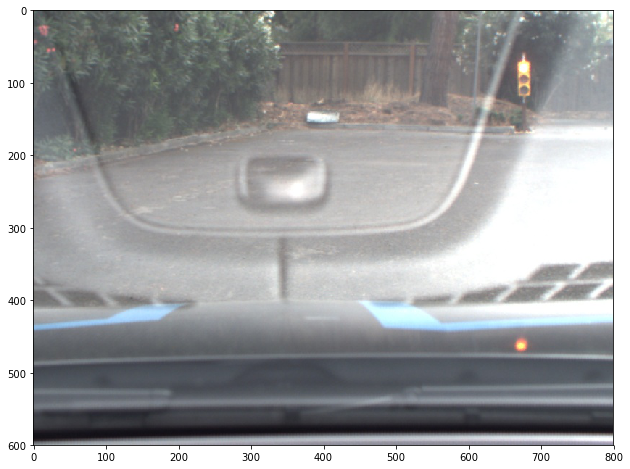

Time in ms:  81.21705055236816 



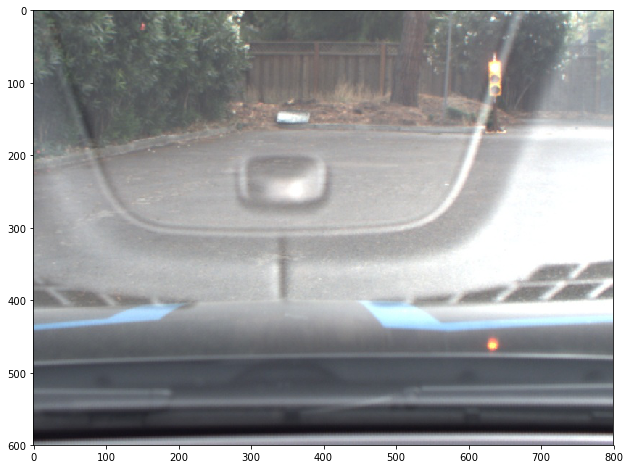

Time in ms:  80.21402359008789 



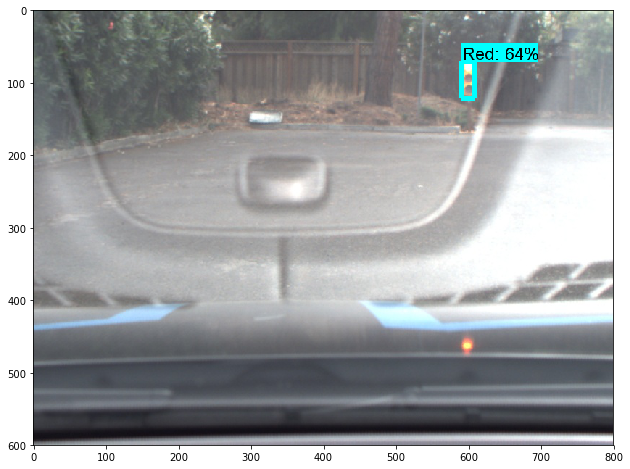

Time in ms:  81.21633529663086 



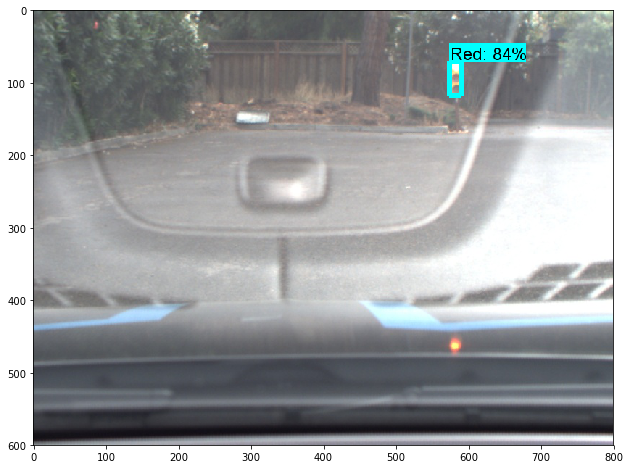

Time in ms:  80.71589469909668 



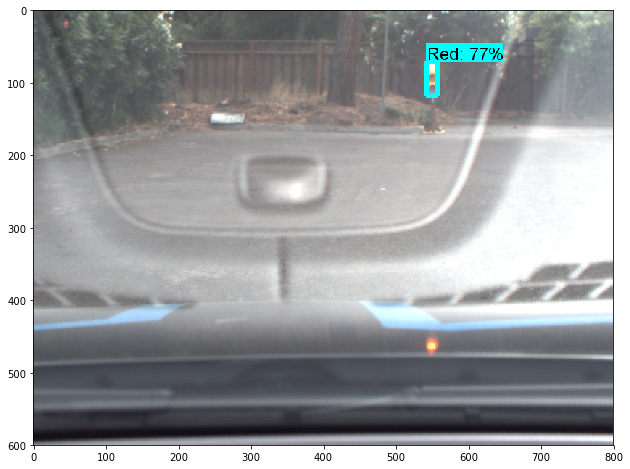

Time in ms:  81.71820640563965 



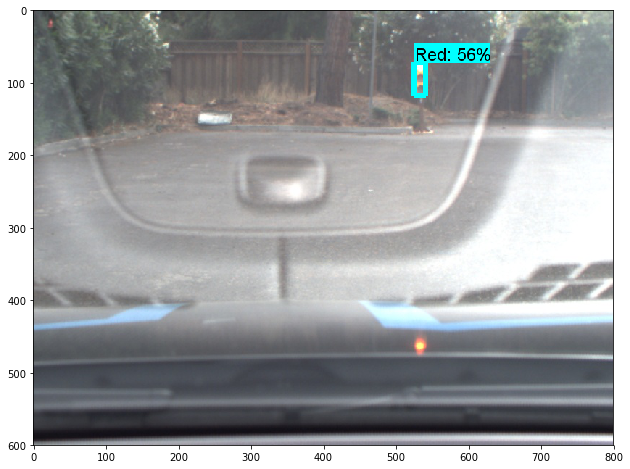

Time in ms:  80.71589469909668 



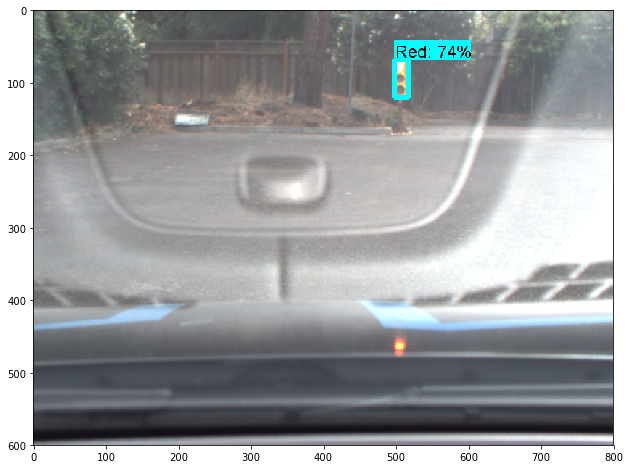

Time in ms:  81.21919631958008 



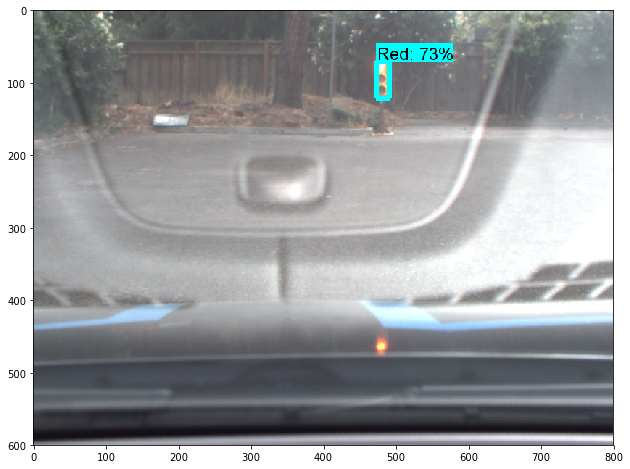

Time in ms:  82.22055435180664 



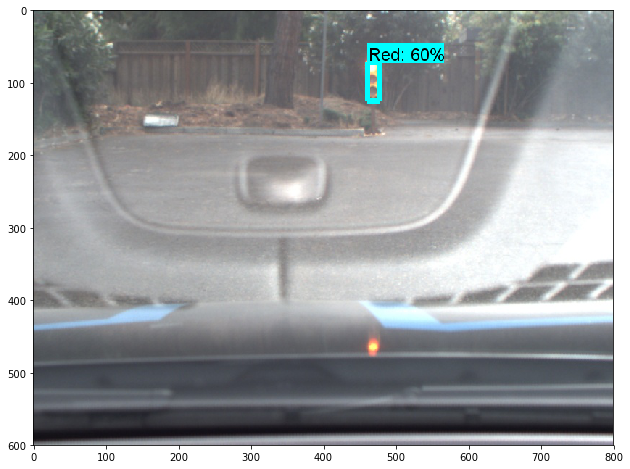

Time in ms:  82.22055435180664 



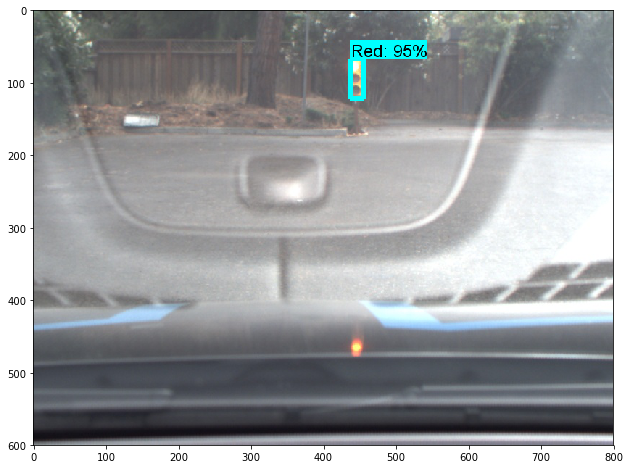

Time in ms:  86.23051643371582 



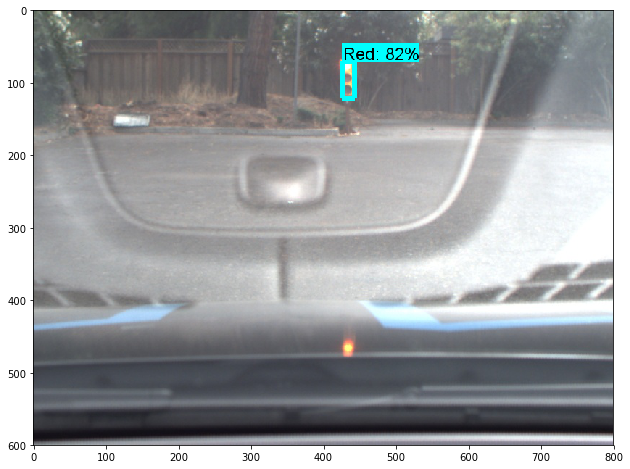

Time in ms:  81.21705055236816 



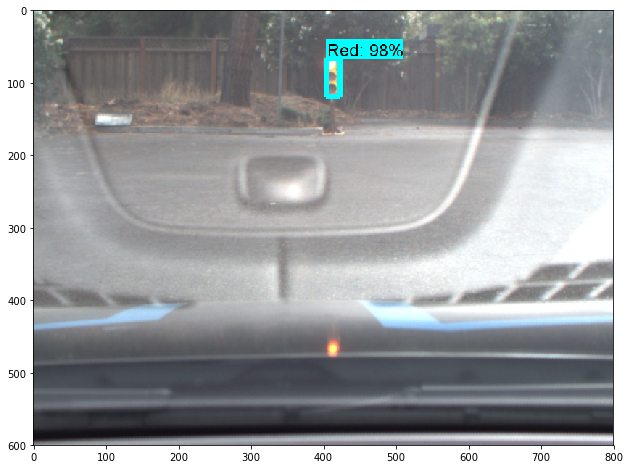

Time in ms:  81.21609687805176 



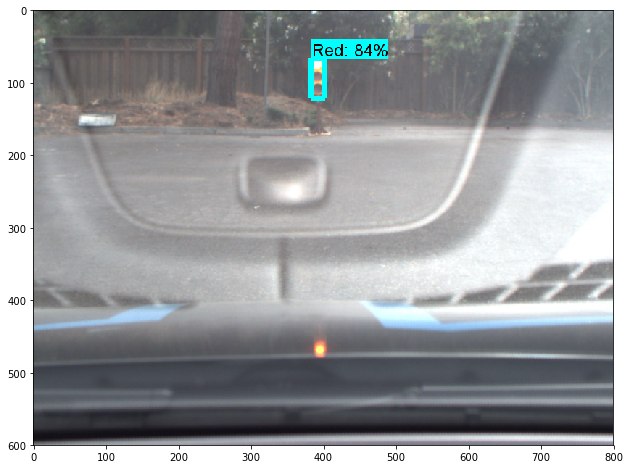

Time in ms:  82.72147178649902 



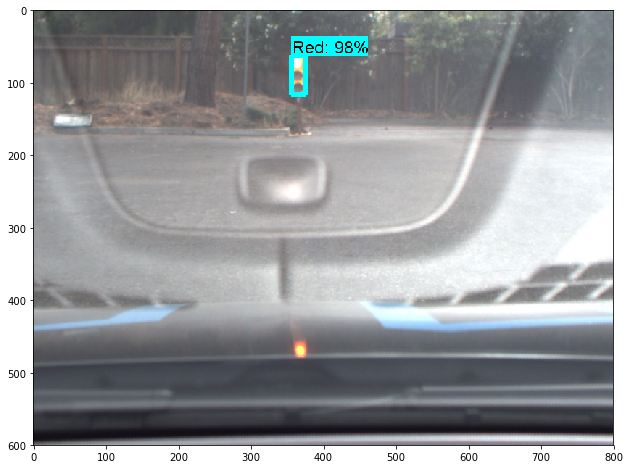

Time in ms:  84.72681045532227 



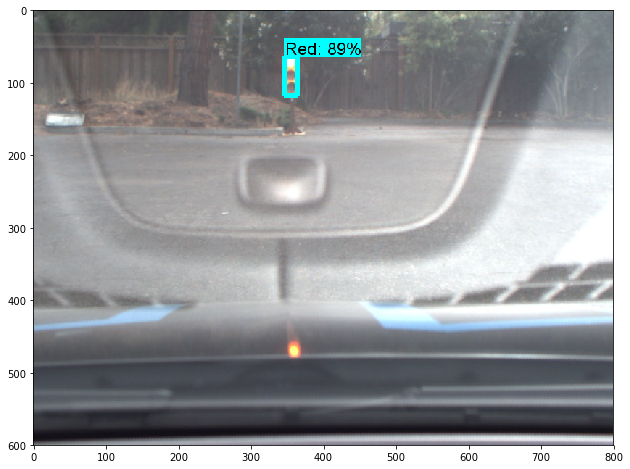

Time in ms:  81.21705055236816 



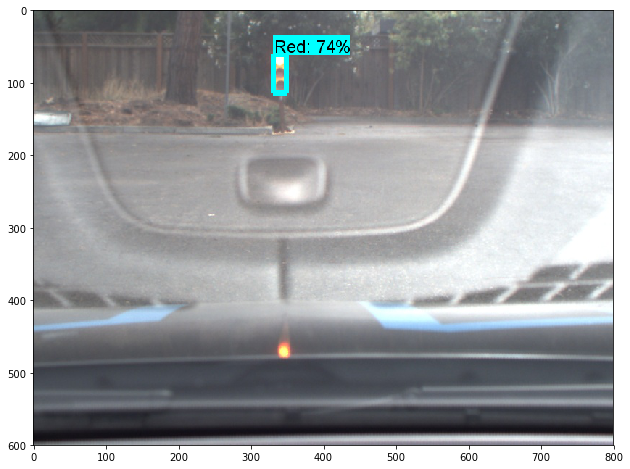

Time in ms:  84.72514152526855 



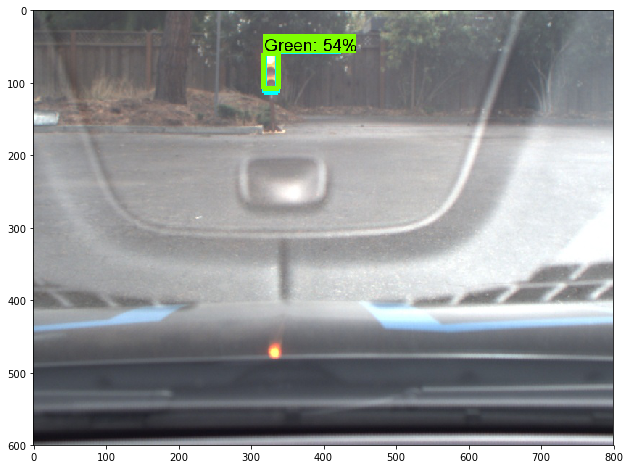

Time in ms:  80.71541786193848 



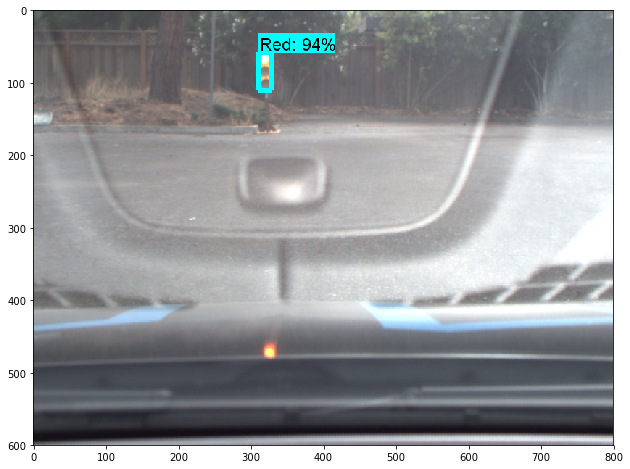

Time in ms:  83.22405815124512 



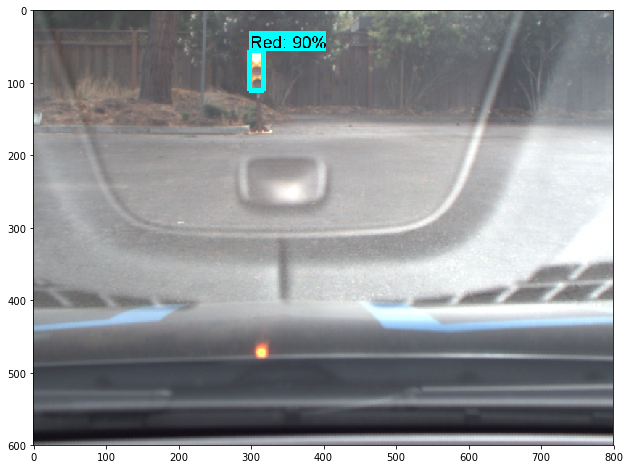

Time in ms:  82.22007751464844 



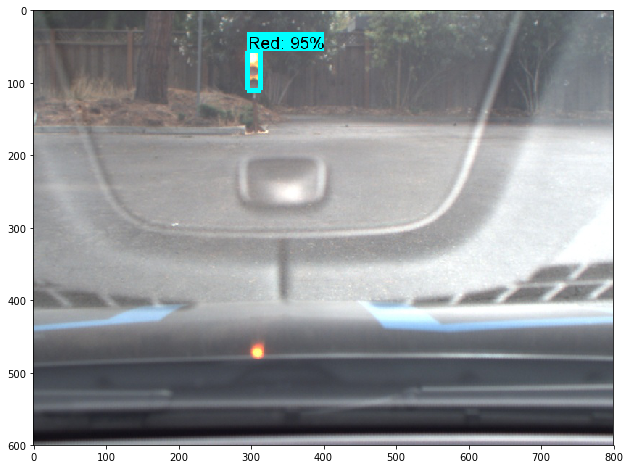

Time in ms:  84.72514152526855 



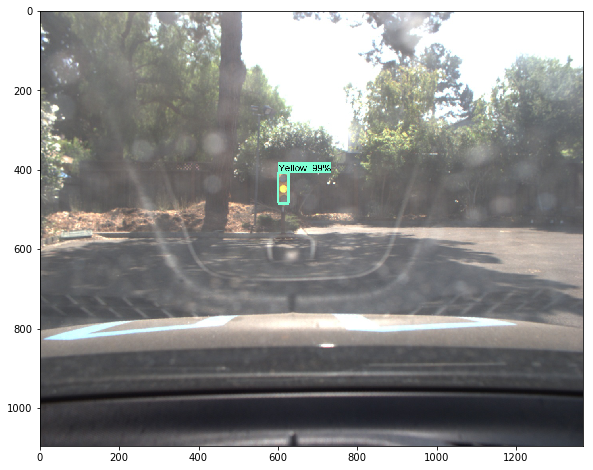

Time in ms:  82.22055435180664 



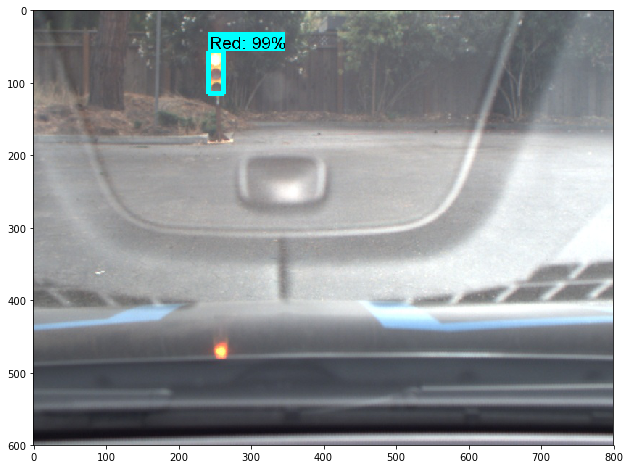

Time in ms:  80.71541786193848 



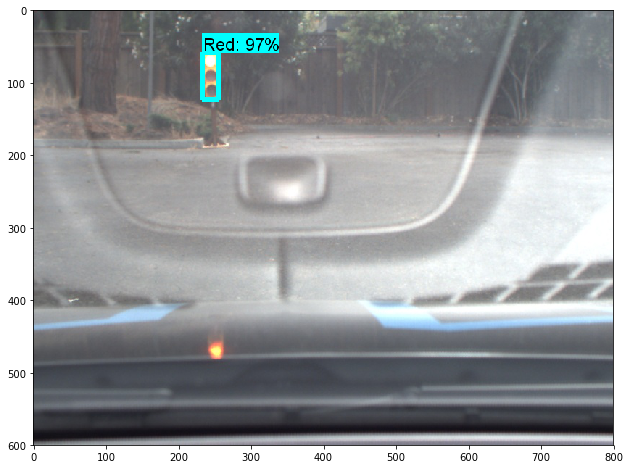

Time in ms:  82.72004127502441 



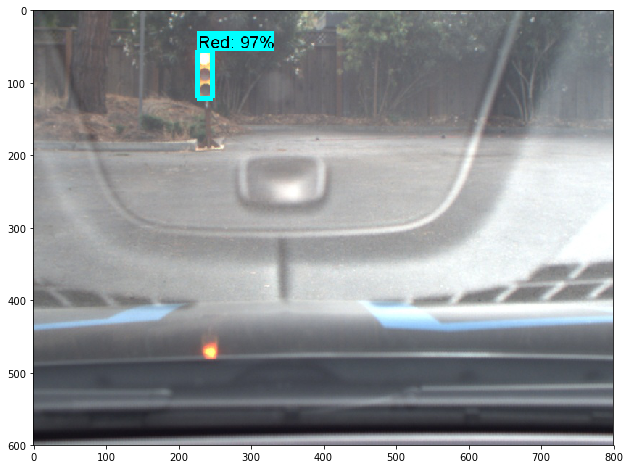

Time in ms:  84.22350883483887 



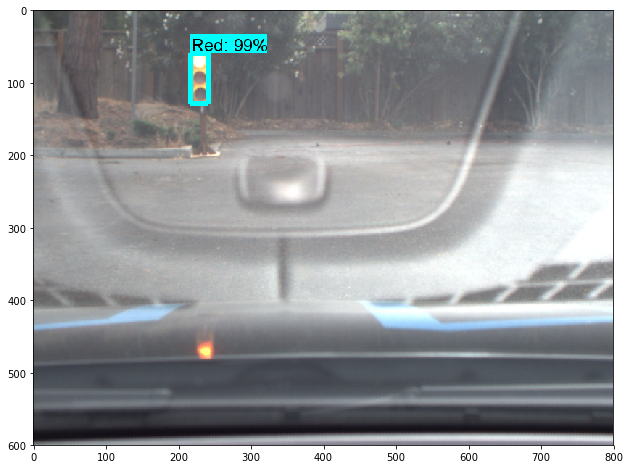

Time in ms:  83.22334289550781 



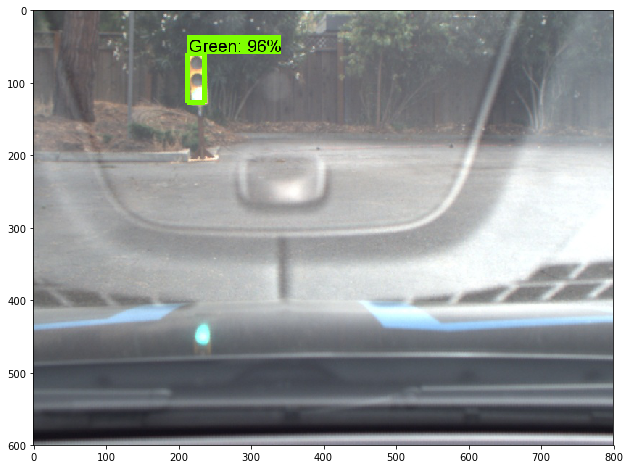

Time in ms:  80.2145004272461 



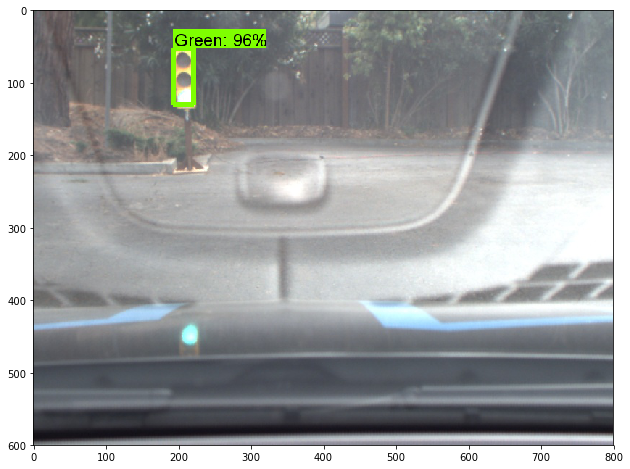

Time in ms:  82.22031593322754 



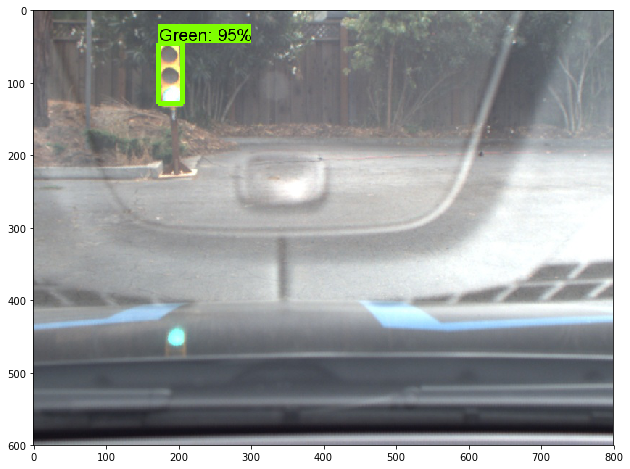

Time in ms:  81.71868324279785 



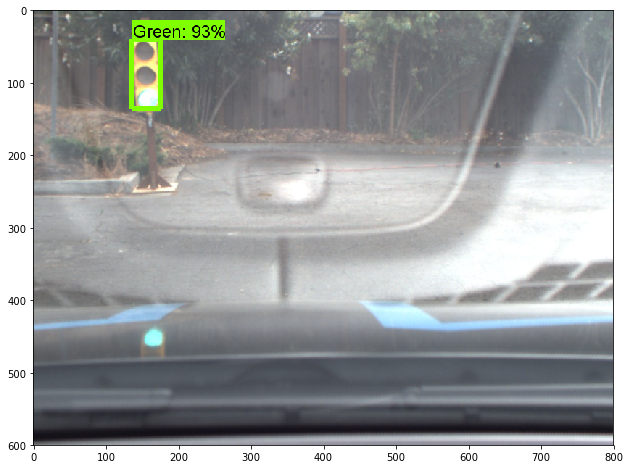

Time in ms:  85.23011207580566 



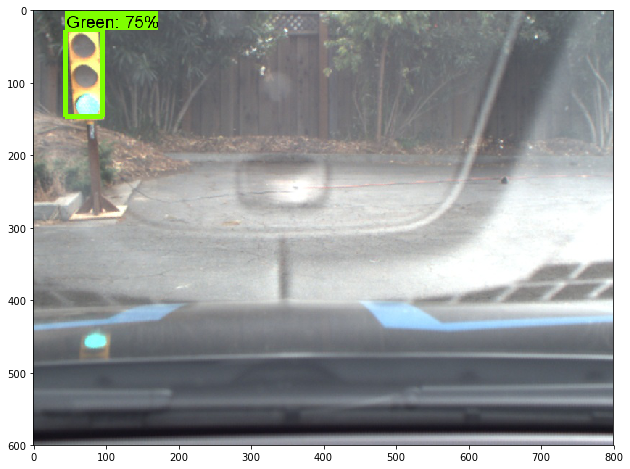

Time in ms:  84.22493934631348 



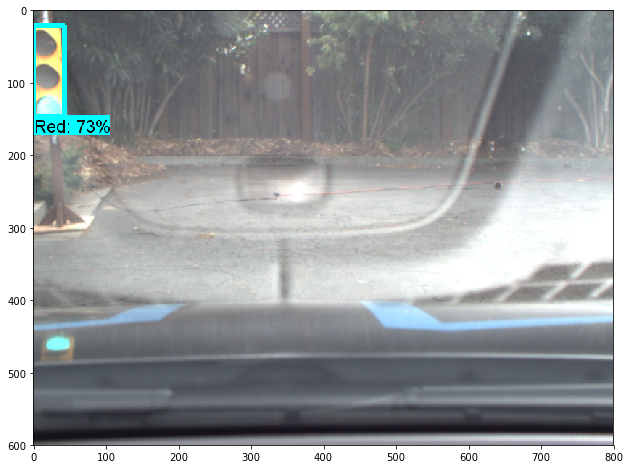

Time in ms:  84.22541618347168 



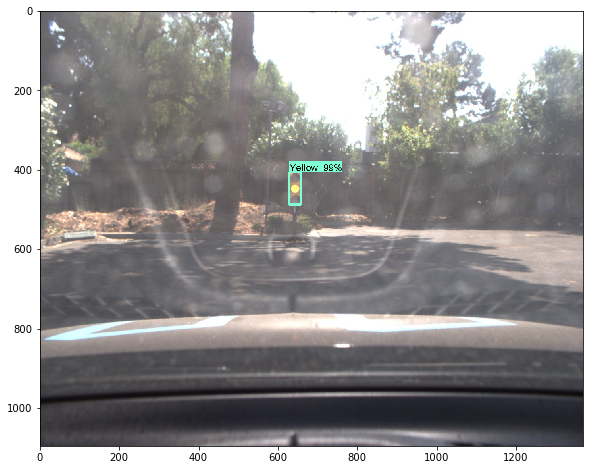

Time in ms:  83.22358131408691 



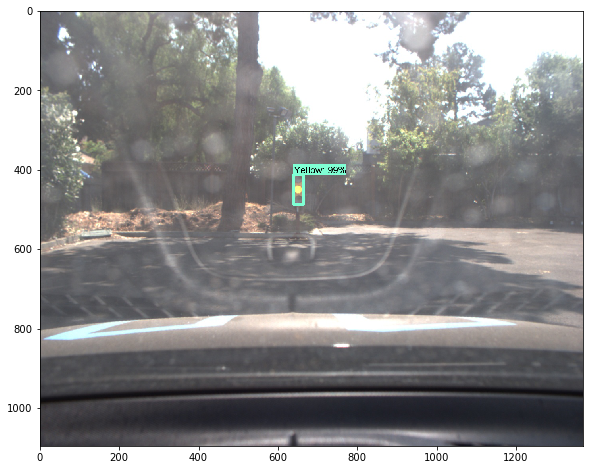

Time in ms:  82.72242546081543 



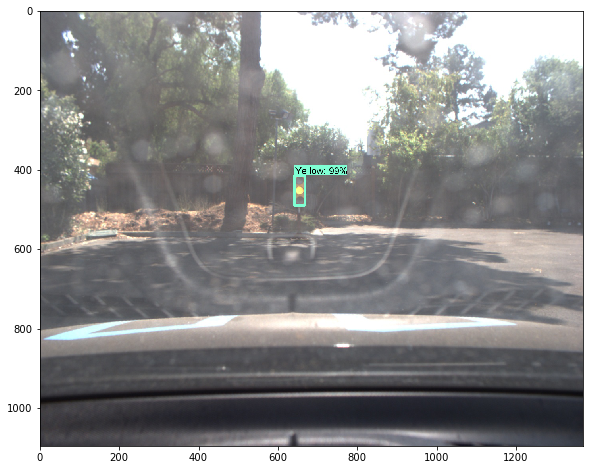

Time in ms:  85.22820472717285 



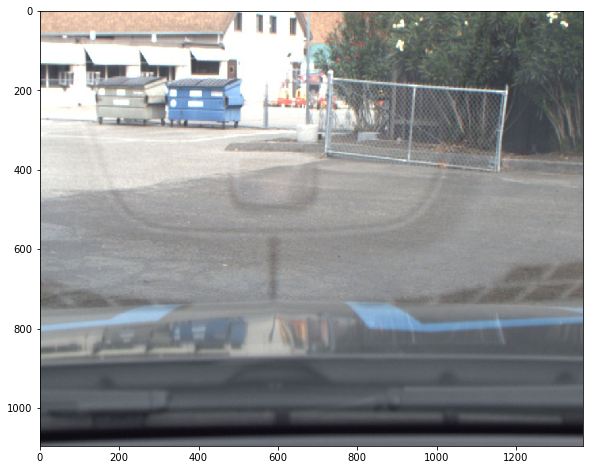

Time in ms:  86.23075485229492 



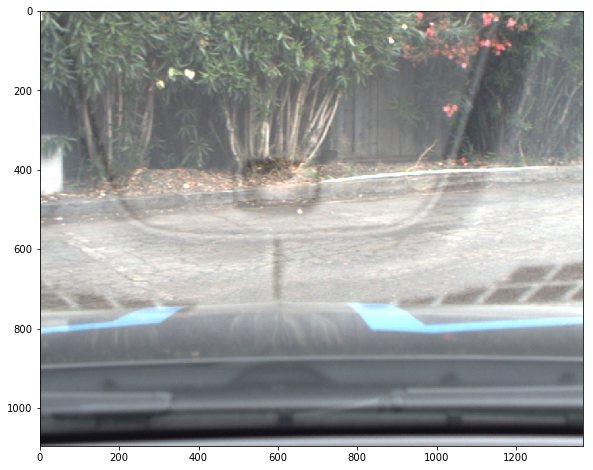

Time in ms:  82.21983909606934 



In [9]:
# The time for the first image includes startup time for tensorflow
with detection_graph.as_default():
  with tf.Session(graph=detection_graph) as sess:
    # Definite input and output Tensors for detection_graph
    image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
    # Each box represents a part of the image where a particular object was detected.
    detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
    # Each score represent how level of confidence for each of the objects.
    # Score is shown on the result image, together with the class label.
    detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
    detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
    num_detections = detection_graph.get_tensor_by_name('num_detections:0')
    for image_path in TEST_IMAGE_PATHS:
      image = Image.open(image_path)
      # the array based representation of the image will be used later in order to prepare the
      # result image with boxes and labels on it.
      image_np = load_image_into_numpy_array(image)
      # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
      image_np_expanded = np.expand_dims(image_np, axis=0)
        
      # Actual detection.
      time0 = time.time()
      (boxes, scores, classes, num) = sess.run(
          [detection_boxes, detection_scores, detection_classes, num_detections],
          feed_dict={image_tensor: image_np_expanded})
      time1 = time.time()
        
      # Visualization of the results of a detection.
      vis_util.visualize_boxes_and_labels_on_image_array(
          image_np,
          np.squeeze(boxes),
          np.squeeze(classes).astype(np.int32),
          np.squeeze(scores),
          category_index,
          use_normalized_coordinates=True,
          line_thickness=7)
      plt.figure(figsize=IMAGE_SIZE)
      plt.rcParams.update({'figure.max_open_warning': 0})
      plt.imshow(image_np)
      plt.show()
      print("Time in ms: ", (time1 - time0) * 1000, "\n")

# Model preparation for trial23_rfcn_resnet_real_12459_frozen_inference_graph

In [6]:
# What model to download.

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = os.path.join('models', 'trial23_rfcn_resnet_real_12459_frozen_inference_graph.pb')

### Load a (frozen) Tensorflow model into memory.

In [7]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

## trial23_rfcn_resnet_real_12459_frozen_inference_graph
## Detection on Real Images

In [8]:
from glob import glob
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = 'test_images_real'
TEST_IMAGE_PATHS = glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.jpg'))

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

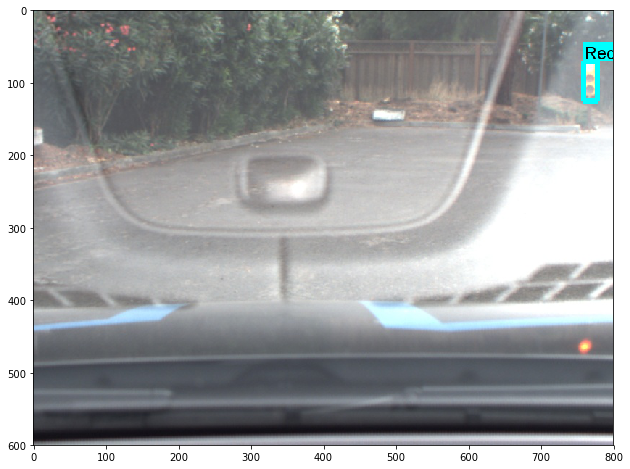

Time in ms:  4094.9206352233887 



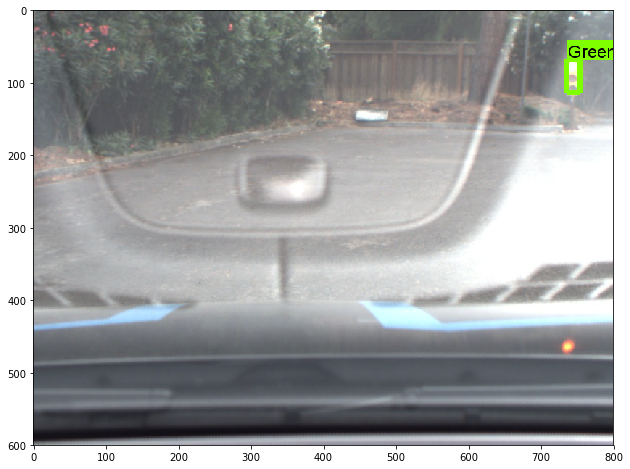

Time in ms:  80.21330833435059 



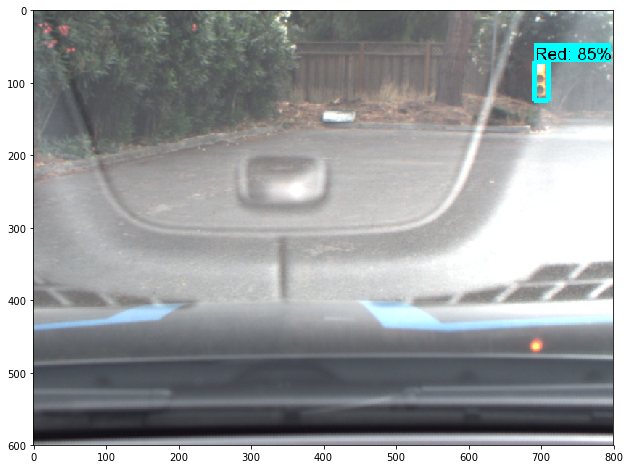

Time in ms:  80.2149772644043 



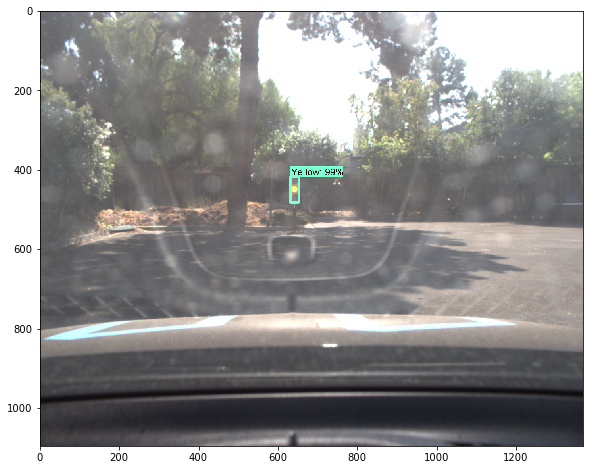

Time in ms:  81.71844482421875 



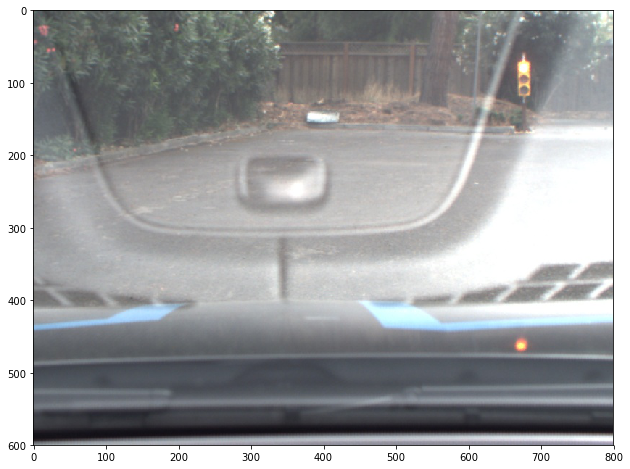

Time in ms:  82.22007751464844 



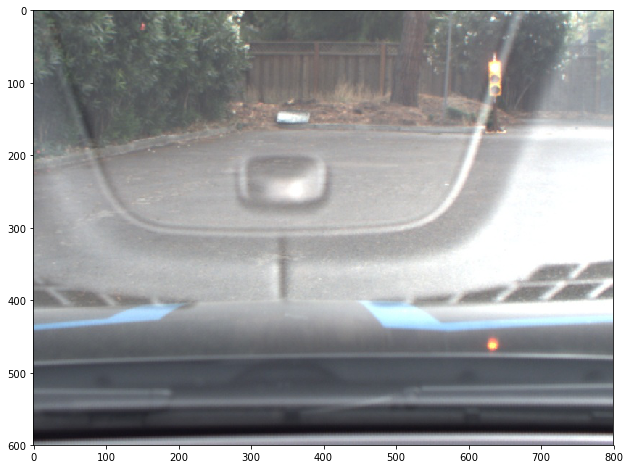

Time in ms:  81.71820640563965 



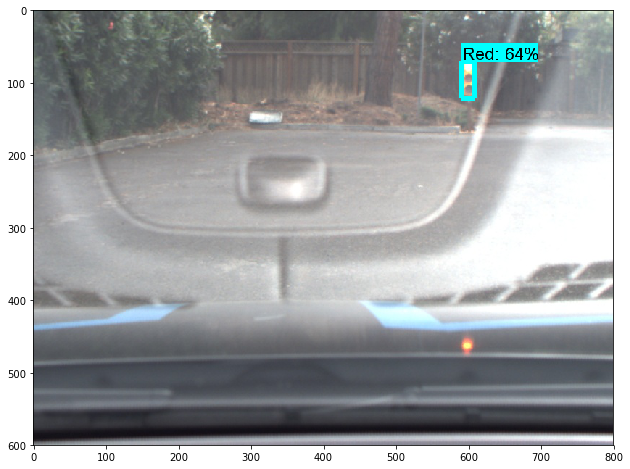

Time in ms:  84.72585678100586 



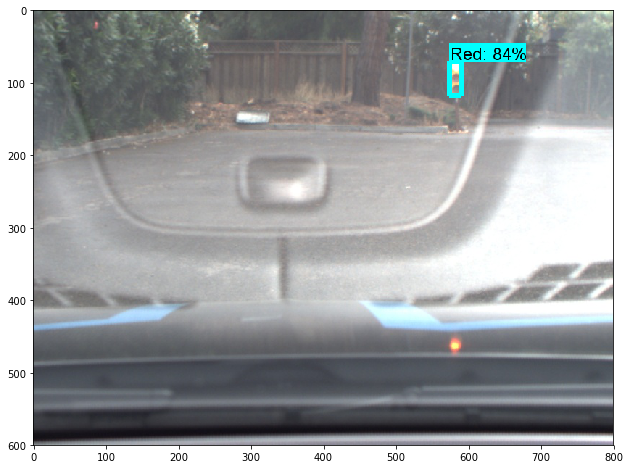

Time in ms:  81.21705055236816 



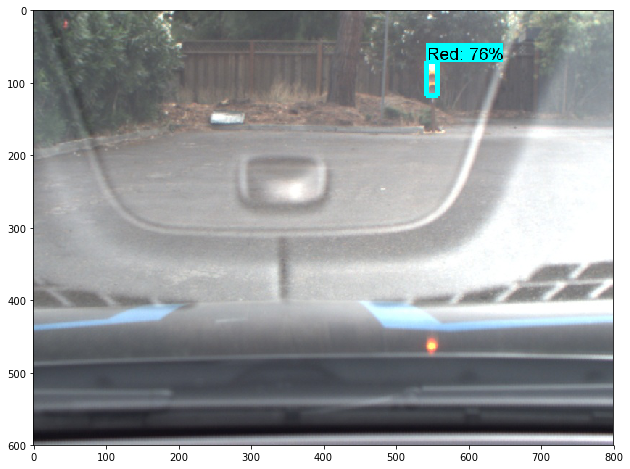

Time in ms:  81.21824264526367 



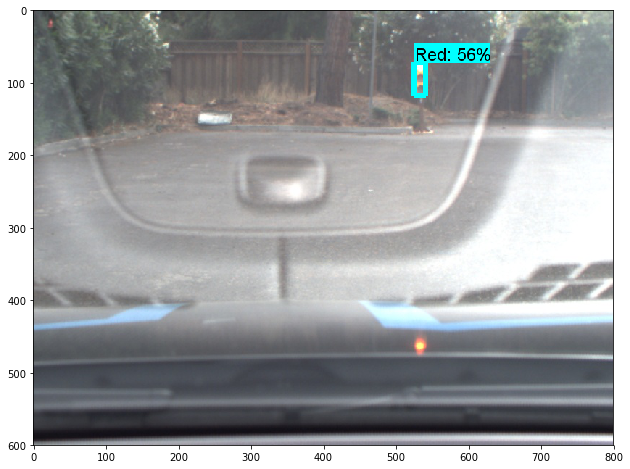

Time in ms:  83.72211456298828 



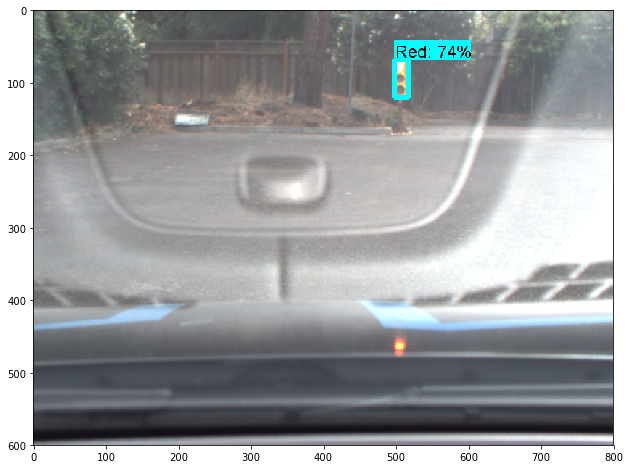

Time in ms:  81.21776580810547 



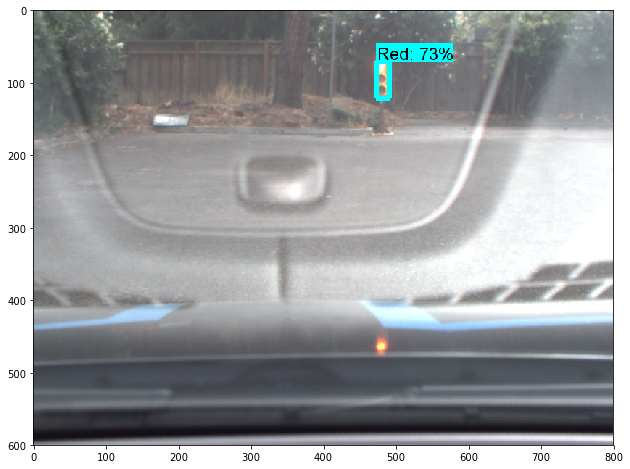

Time in ms:  83.72306823730469 



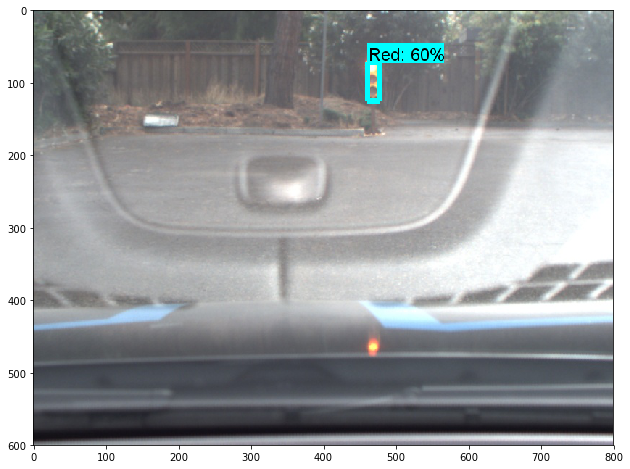

Time in ms:  80.71446418762207 



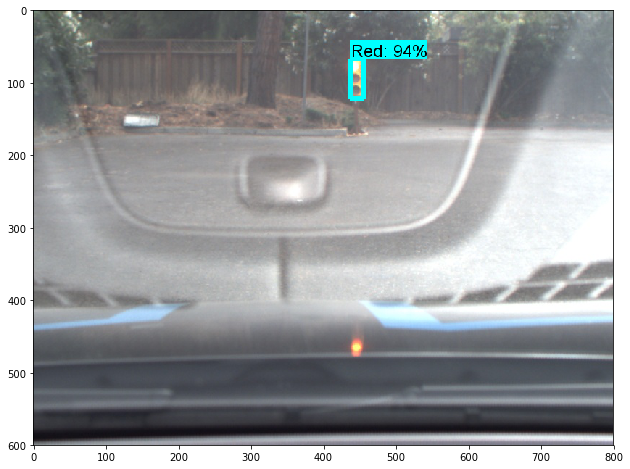

Time in ms:  81.21633529663086 



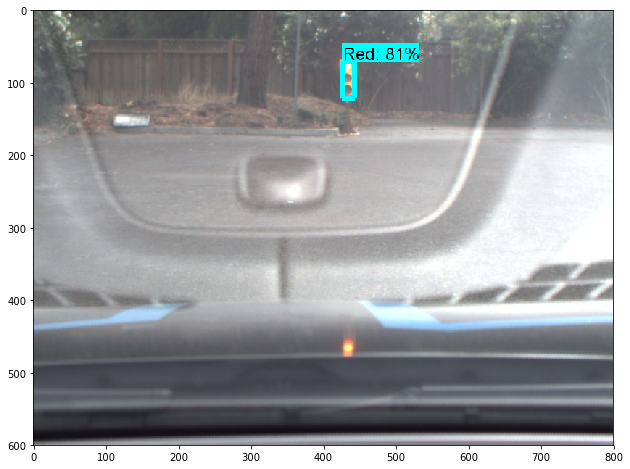

Time in ms:  80.2145004272461 



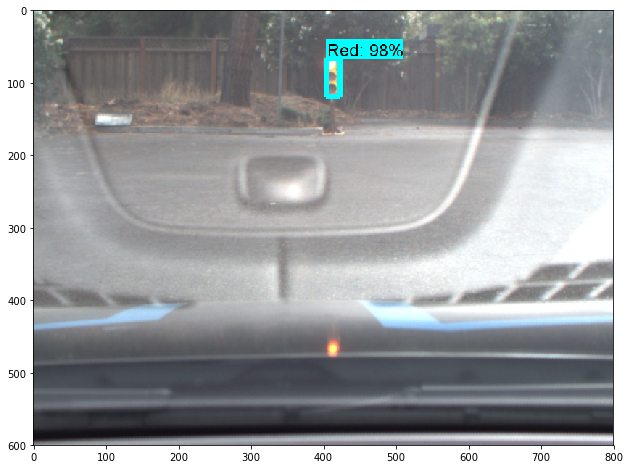

Time in ms:  81.21609687805176 



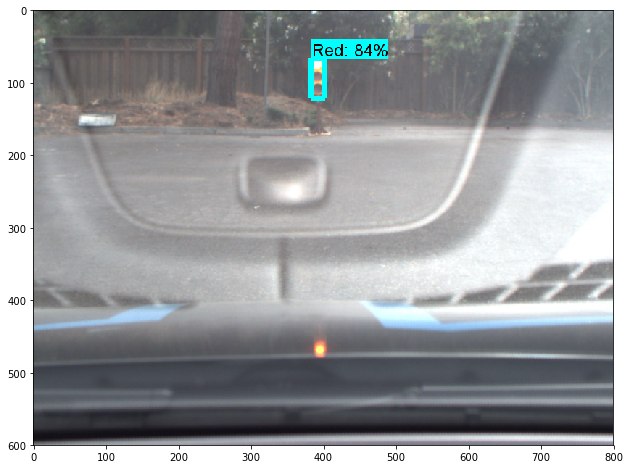

Time in ms:  80.71565628051758 



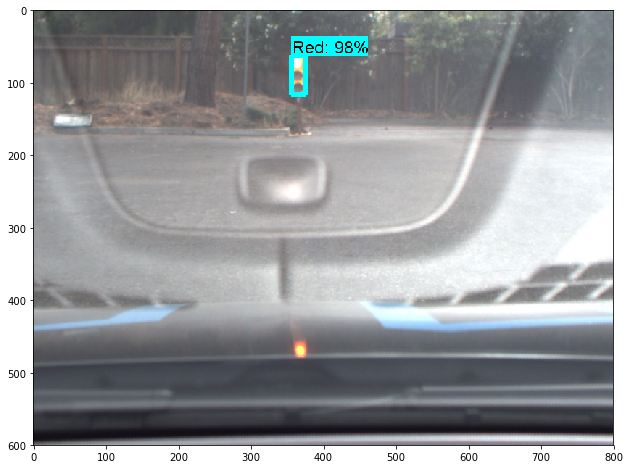

Time in ms:  81.71820640563965 



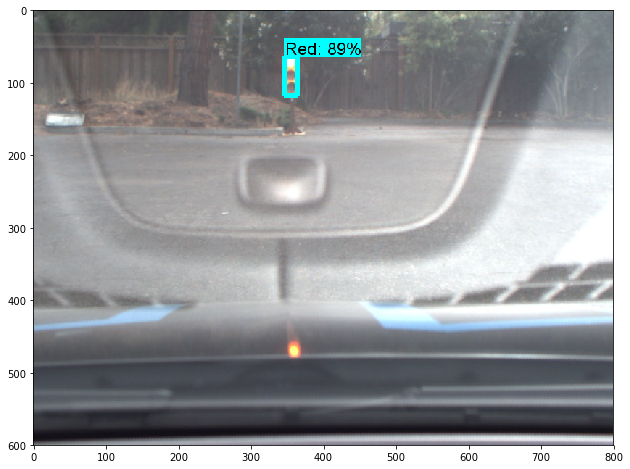

Time in ms:  81.21728897094727 



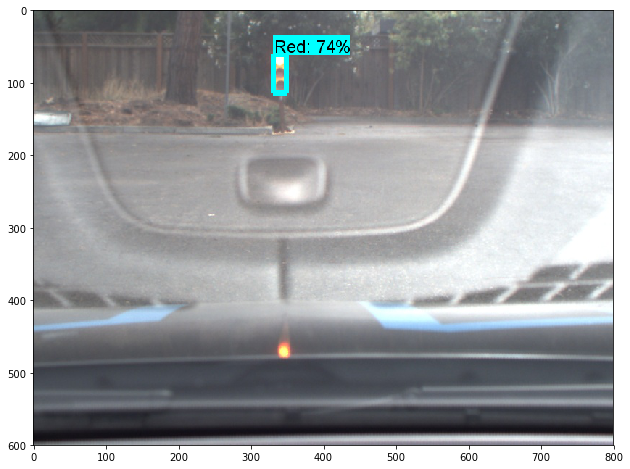

Time in ms:  80.2152156829834 



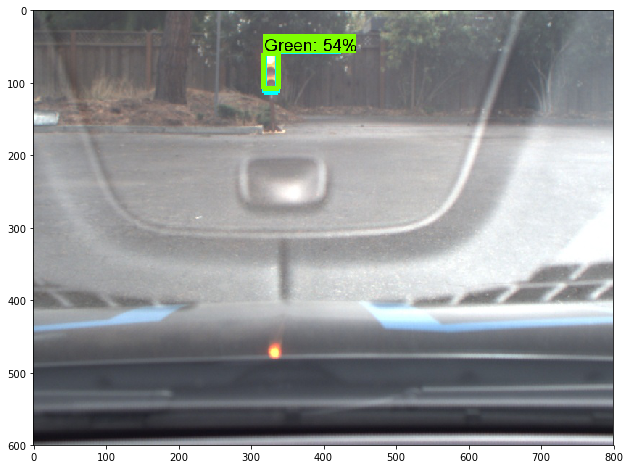

Time in ms:  82.22007751464844 



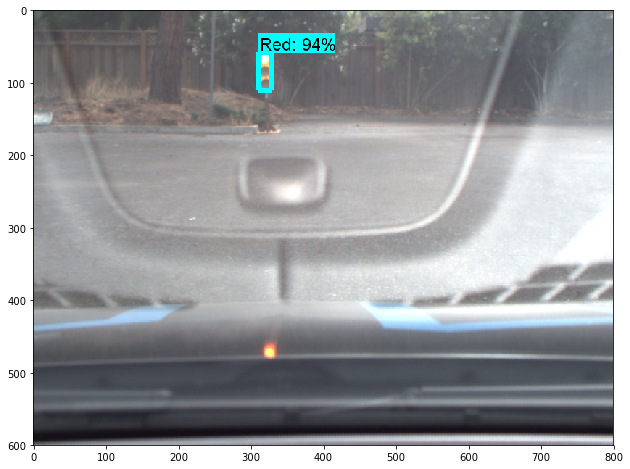

Time in ms:  81.21848106384277 



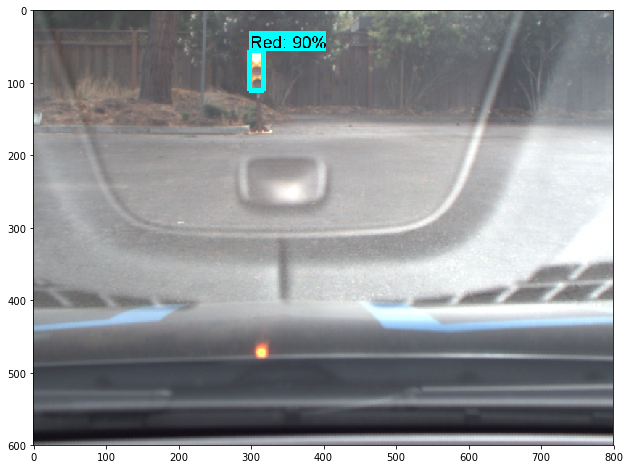

Time in ms:  81.21752738952637 



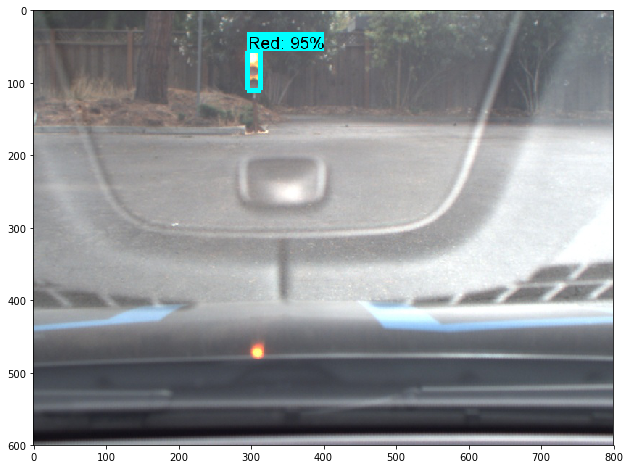

Time in ms:  81.71820640563965 



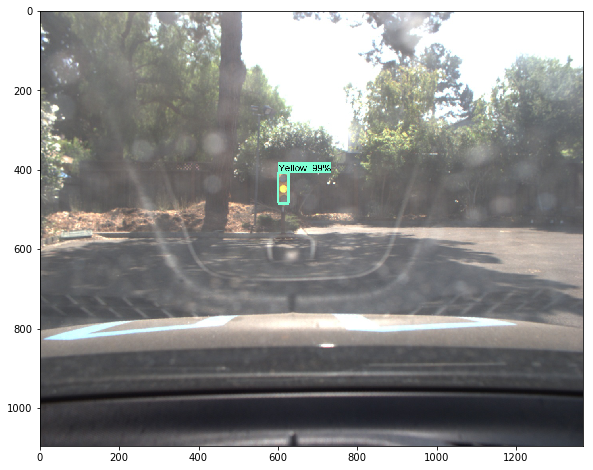

Time in ms:  82.21864700317383 



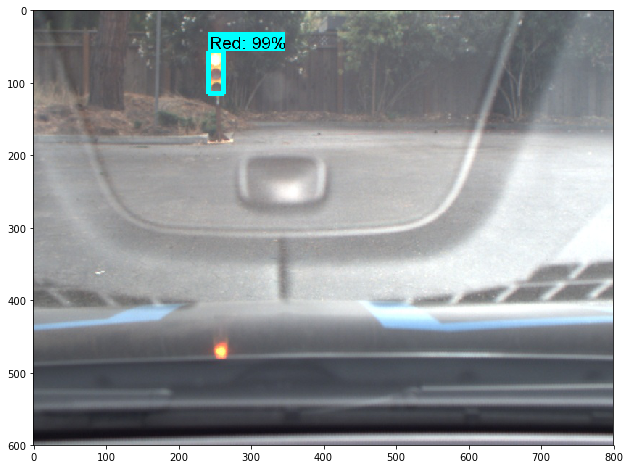

Time in ms:  80.71565628051758 



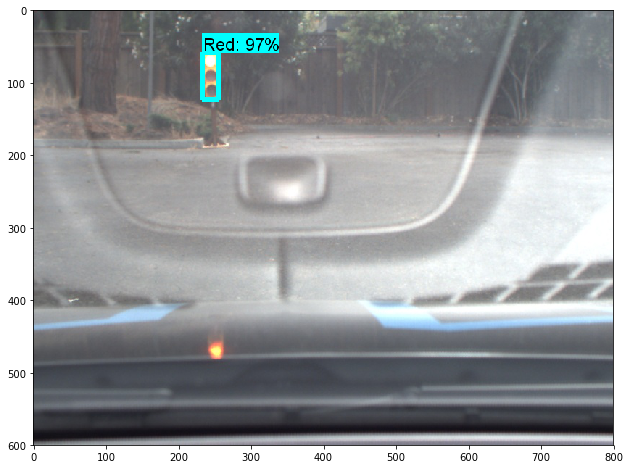

Time in ms:  80.71565628051758 



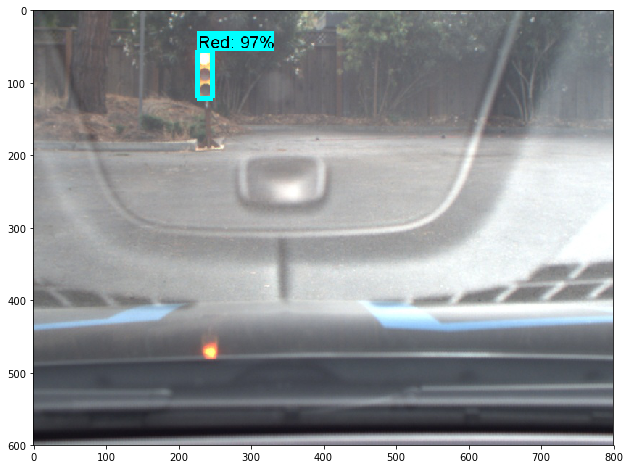

Time in ms:  81.21681213378906 



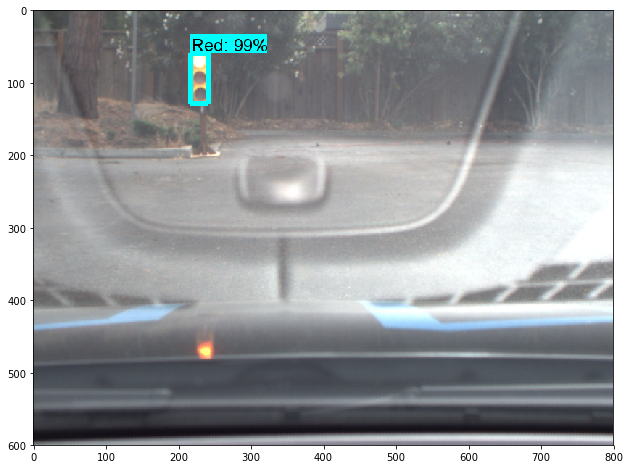

Time in ms:  80.71613311767578 



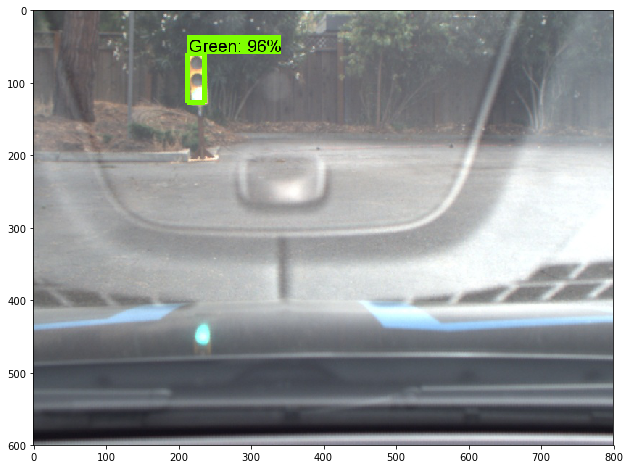

Time in ms:  83.22334289550781 



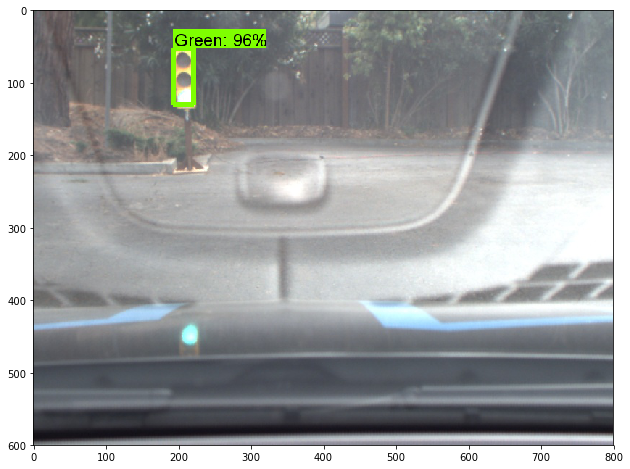

Time in ms:  84.22517776489258 



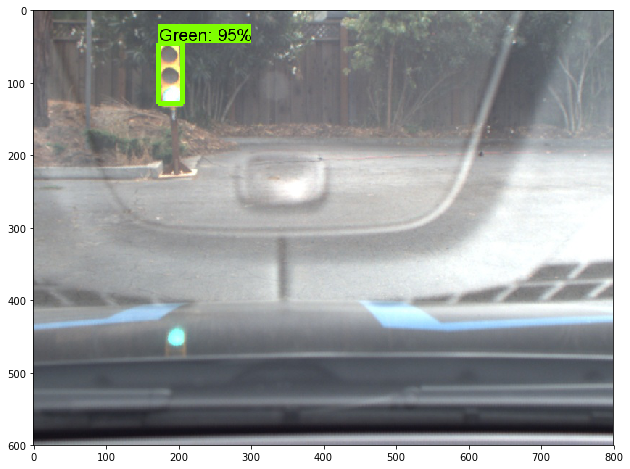

Time in ms:  82.72075653076172 



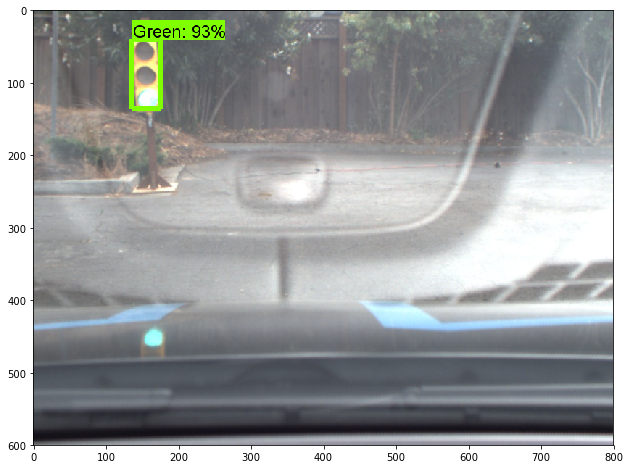

Time in ms:  84.22517776489258 



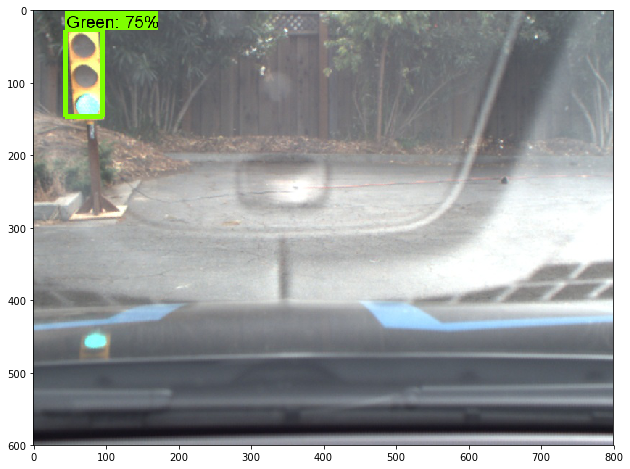

Time in ms:  81.21776580810547 



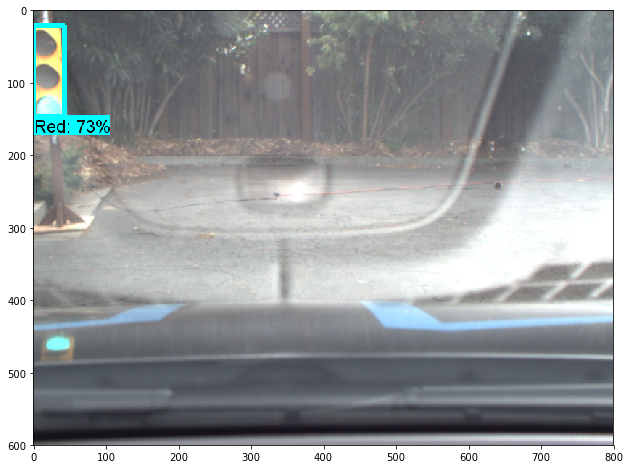

Time in ms:  85.22796630859375 



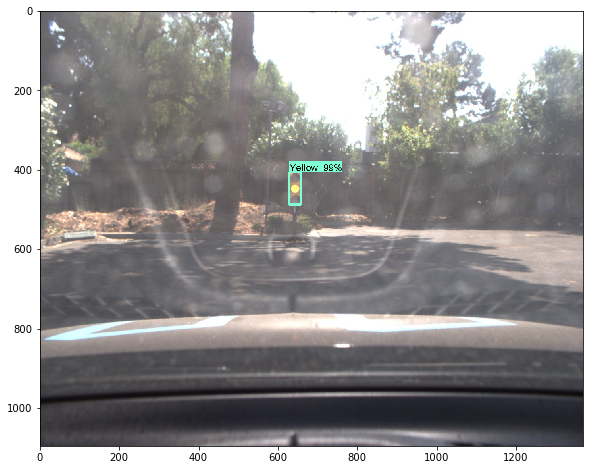

Time in ms:  85.22725105285645 



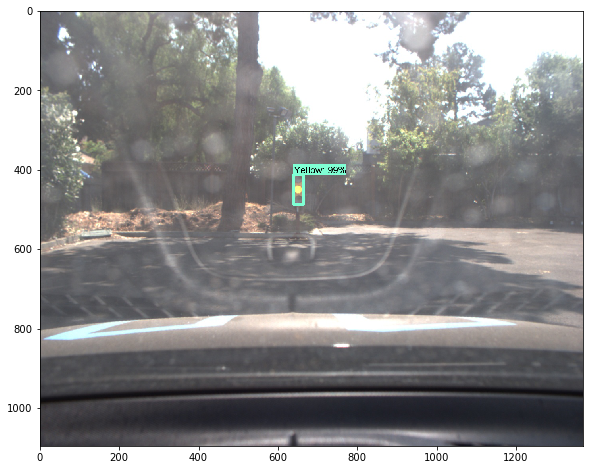

Time in ms:  84.72537994384766 



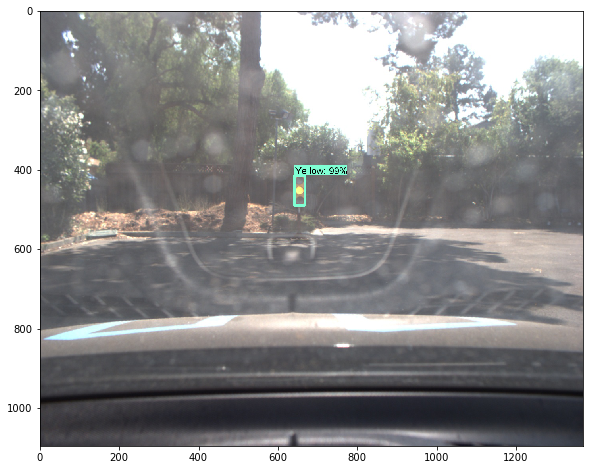

Time in ms:  81.21681213378906 



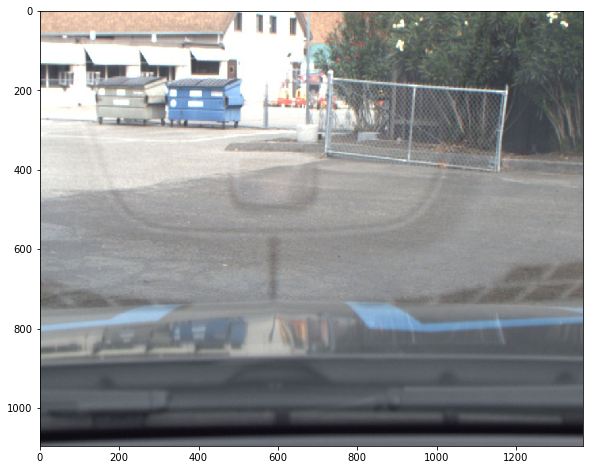

Time in ms:  81.71820640563965 



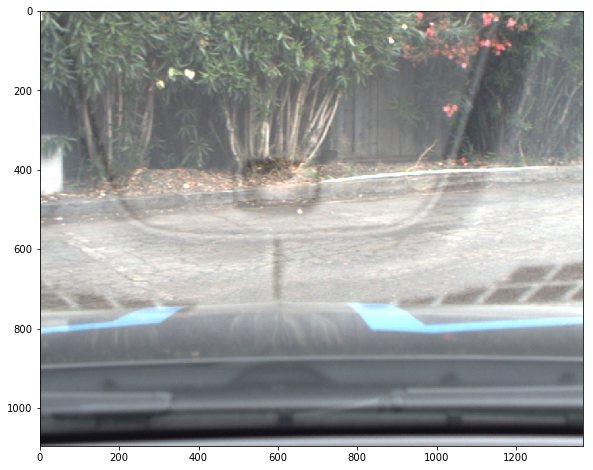

Time in ms:  81.71844482421875 



In [9]:
# The time for the first image includes startup time for tensorflow
with detection_graph.as_default():
  with tf.Session(graph=detection_graph) as sess:
    # Definite input and output Tensors for detection_graph
    image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
    # Each box represents a part of the image where a particular object was detected.
    detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
    # Each score represent how level of confidence for each of the objects.
    # Score is shown on the result image, together with the class label.
    detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
    detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
    num_detections = detection_graph.get_tensor_by_name('num_detections:0')
    for image_path in TEST_IMAGE_PATHS:
      image = Image.open(image_path)
      # the array based representation of the image will be used later in order to prepare the
      # result image with boxes and labels on it.
      image_np = load_image_into_numpy_array(image)
      # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
      image_np_expanded = np.expand_dims(image_np, axis=0)
        
      # Actual detection.
      time0 = time.time()
      (boxes, scores, classes, num) = sess.run(
          [detection_boxes, detection_scores, detection_classes, num_detections],
          feed_dict={image_tensor: image_np_expanded})
      time1 = time.time()
        
      # Visualization of the results of a detection.
      vis_util.visualize_boxes_and_labels_on_image_array(
          image_np,
          np.squeeze(boxes),
          np.squeeze(classes).astype(np.int32),
          np.squeeze(scores),
          category_index,
          use_normalized_coordinates=True,
          line_thickness=7)
      plt.figure(figsize=IMAGE_SIZE)
      plt.rcParams.update({'figure.max_open_warning': 0})
      plt.imshow(image_np)
      plt.show()
      print("Time in ms: ", (time1 - time0) * 1000, "\n")

# Model preparation for trial23_rfcn_resnet_real_7759_frozen_inference_graph

In [6]:
# What model to download.

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = os.path.join('models', 'trial23_rfcn_resnet_real_7759_frozen_inference_graph.pb')

### Load a (frozen) Tensorflow model into memory.

In [7]:
detection_graph = tf.Graph()
with detection_graph.as_default():
  od_graph_def = tf.GraphDef()
  with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
    serialized_graph = fid.read()
    od_graph_def.ParseFromString(serialized_graph)
    tf.import_graph_def(od_graph_def, name='')

## trial23_rfcn_resnet_real_7759_frozen_inference_graph
## Detection on Real Images

In [8]:
from glob import glob
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = 'test_images_real'
TEST_IMAGE_PATHS = glob(os.path.join(PATH_TO_TEST_IMAGES_DIR, '*.jpg'))

# Size, in inches, of the output images.
IMAGE_SIZE = (12, 8)

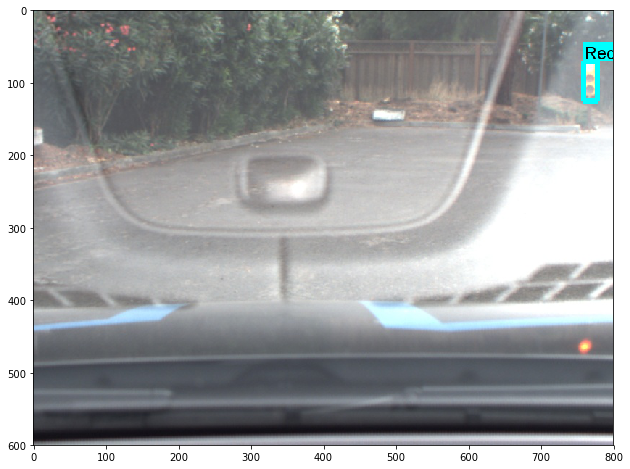

Time in ms:  4094.921588897705 



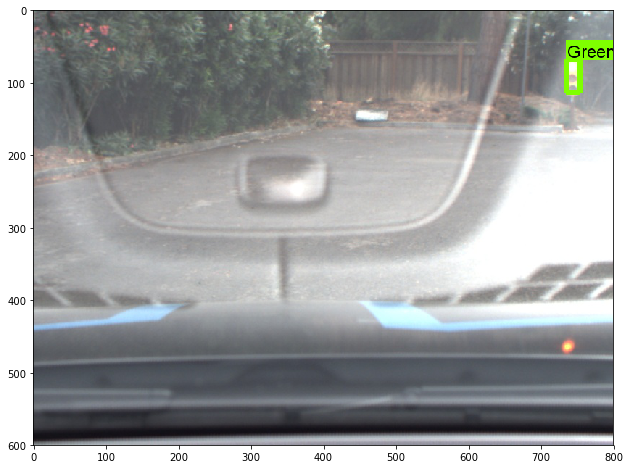

Time in ms:  80.71589469909668 



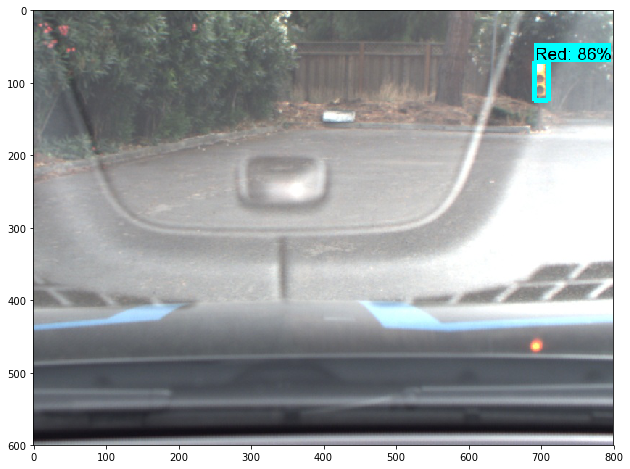

Time in ms:  79.71334457397461 



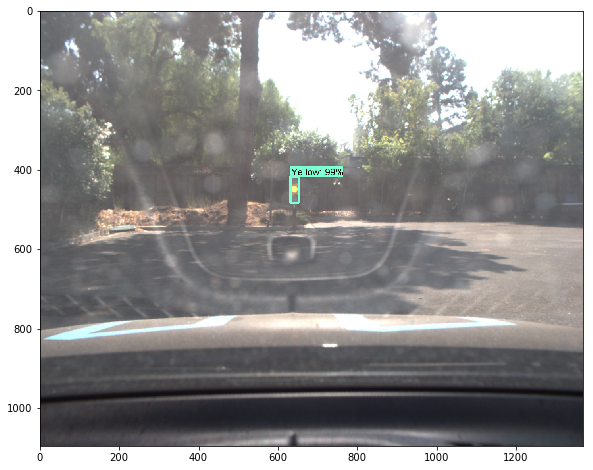

Time in ms:  82.72099494934082 



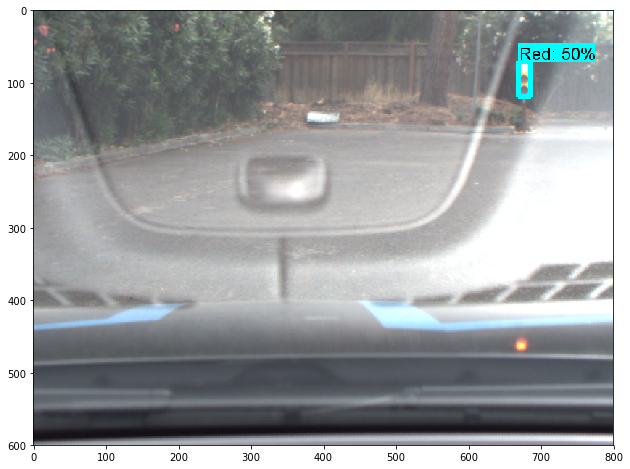

Time in ms:  82.22007751464844 



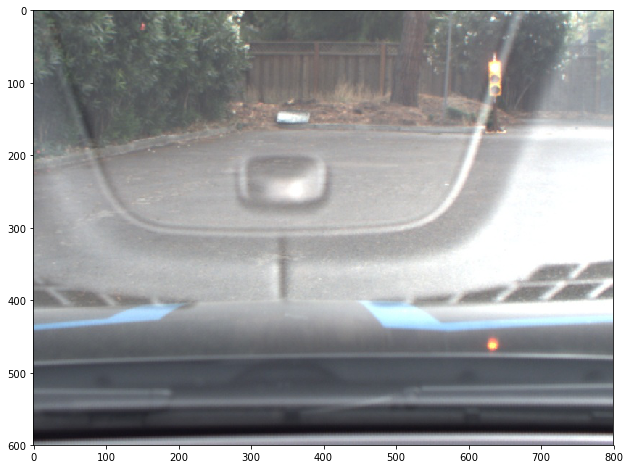

Time in ms:  80.21402359008789 



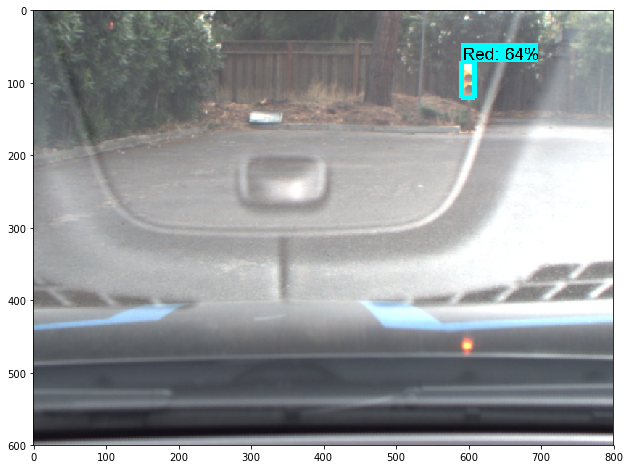

Time in ms:  86.23051643371582 



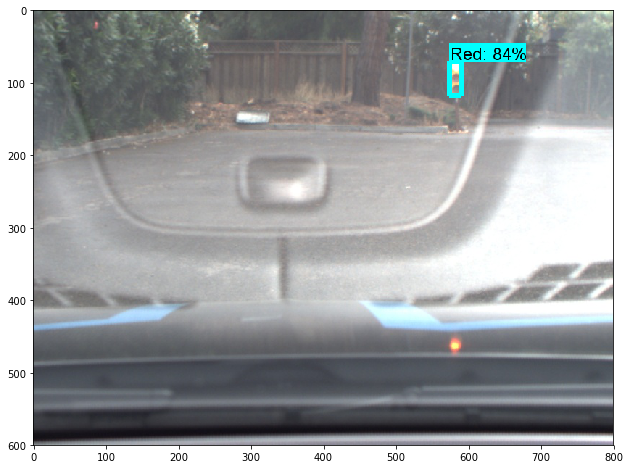

Time in ms:  80.21759986877441 



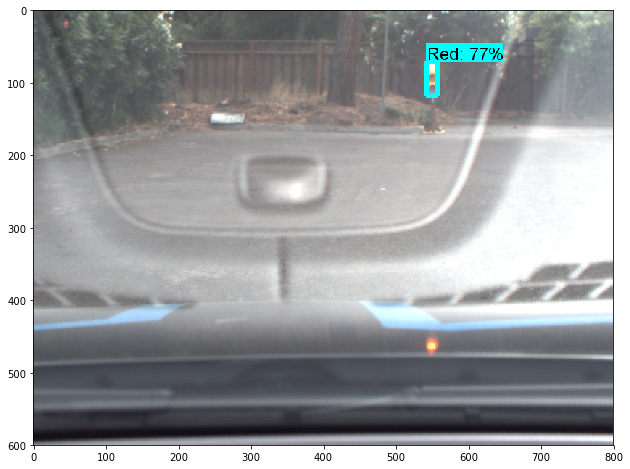

Time in ms:  80.71637153625488 



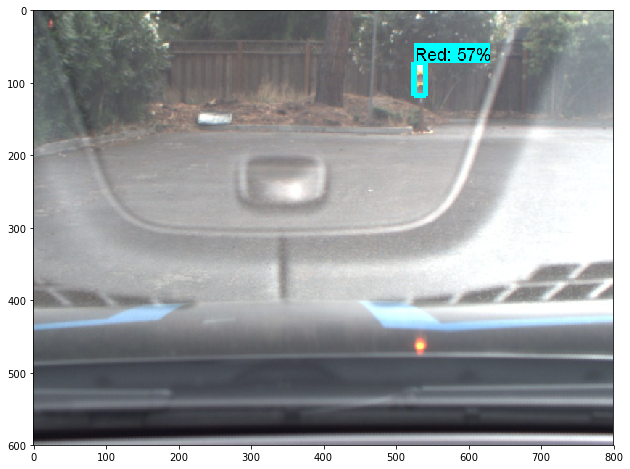

Time in ms:  82.22007751464844 



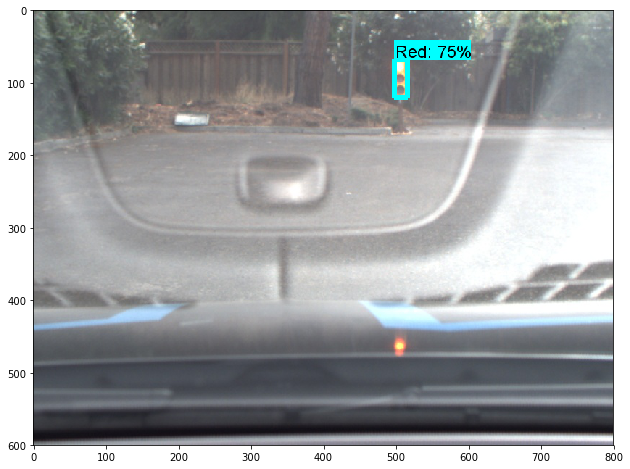

Time in ms:  81.21752738952637 



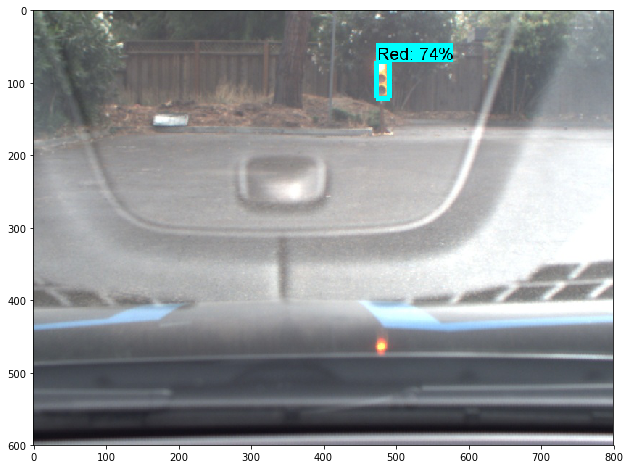

Time in ms:  81.71796798706055 



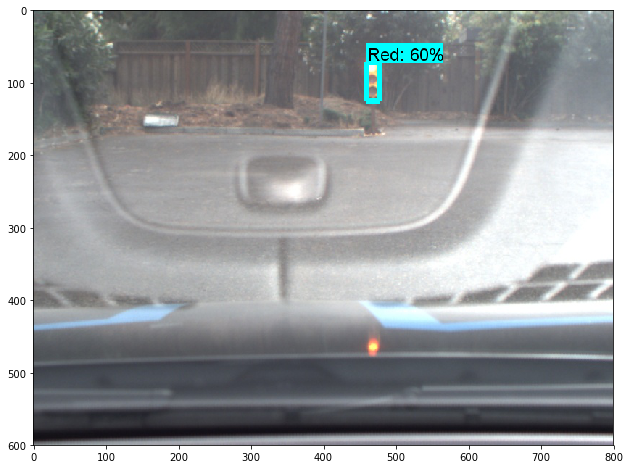

Time in ms:  82.72051811218262 



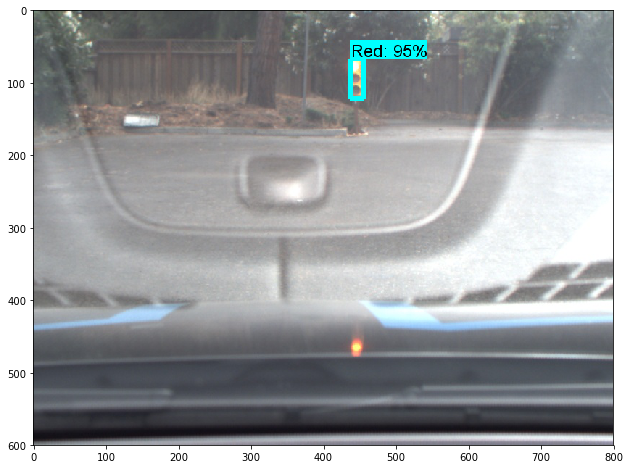

Time in ms:  83.2223892211914 



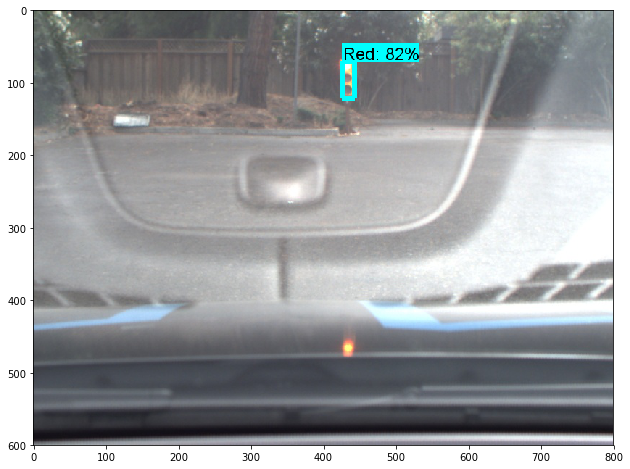

Time in ms:  84.22589302062988 



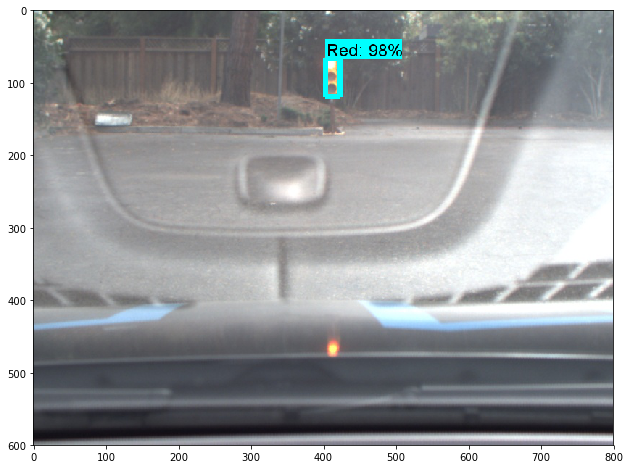

Time in ms:  81.71820640563965 



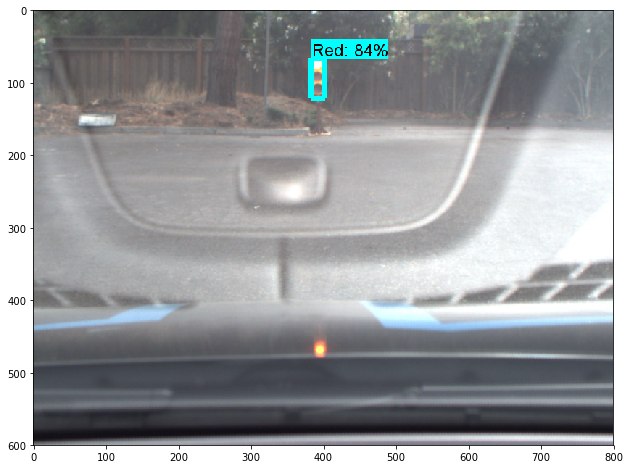

Time in ms:  84.22589302062988 



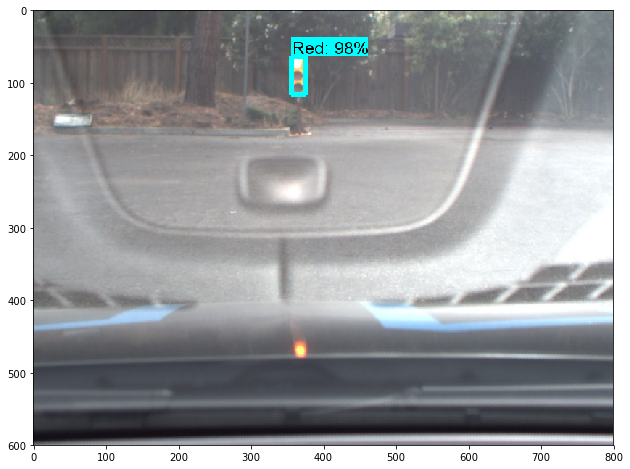

Time in ms:  81.21752738952637 



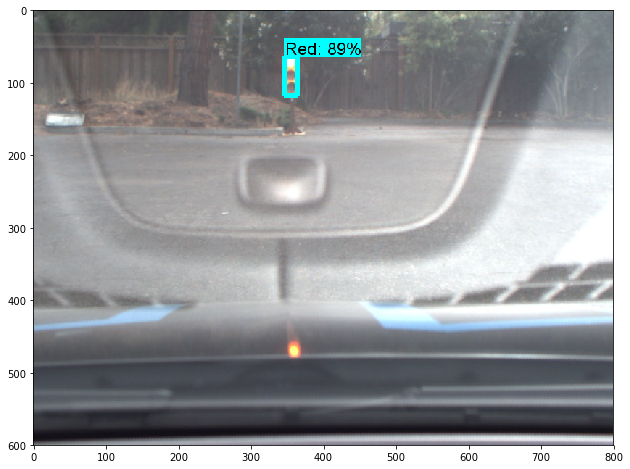

Time in ms:  81.21895790100098 



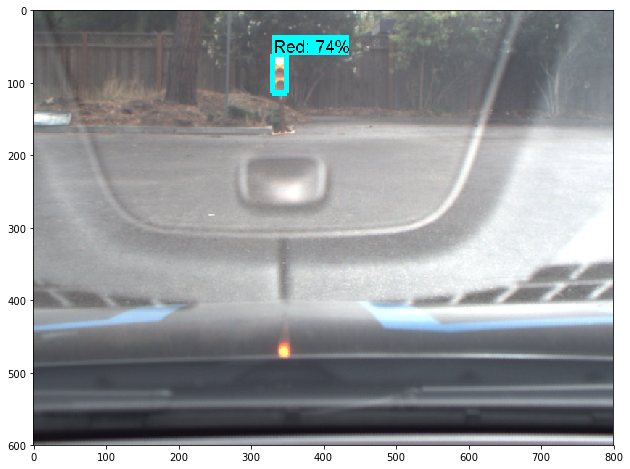

Time in ms:  84.22589302062988 



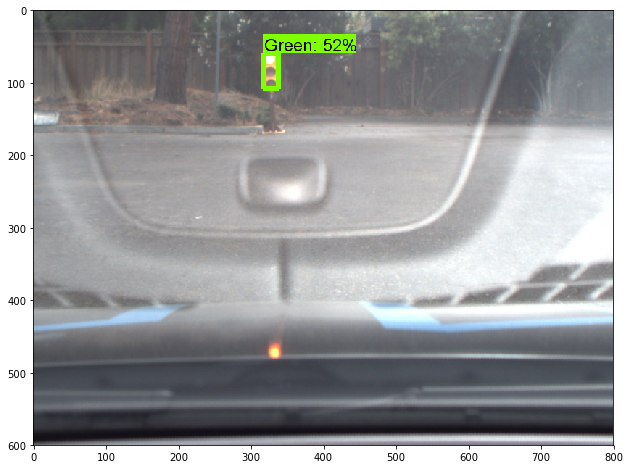

Time in ms:  84.72728729248047 



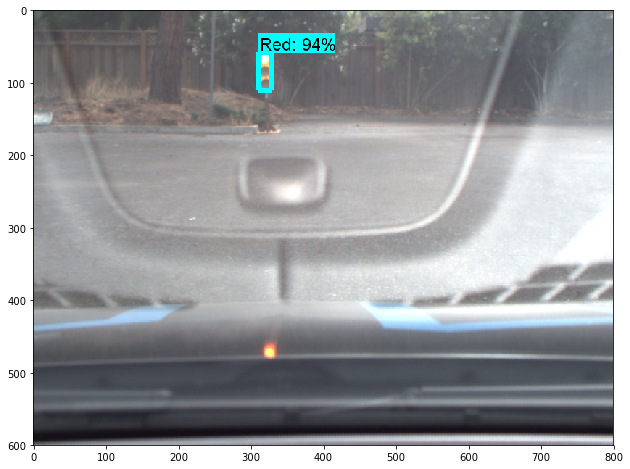

Time in ms:  81.71844482421875 



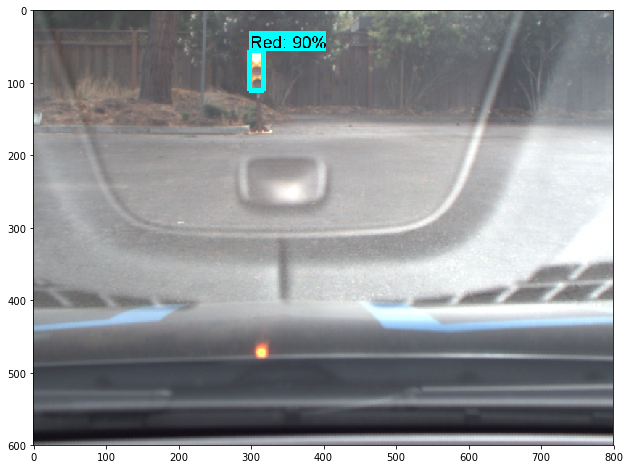

Time in ms:  81.71844482421875 



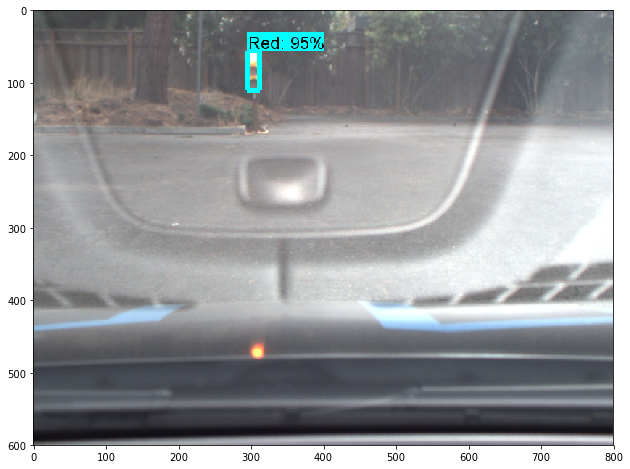

Time in ms:  80.71565628051758 



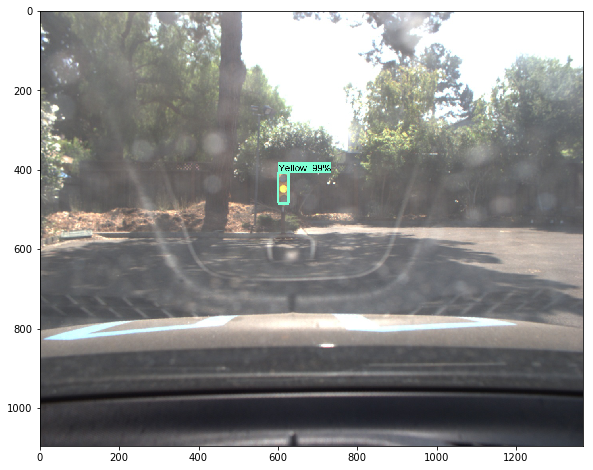

Time in ms:  86.23170852661133 



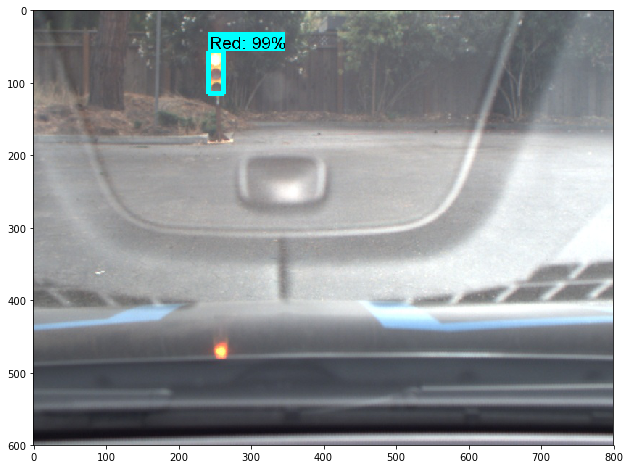

Time in ms:  81.21705055236816 



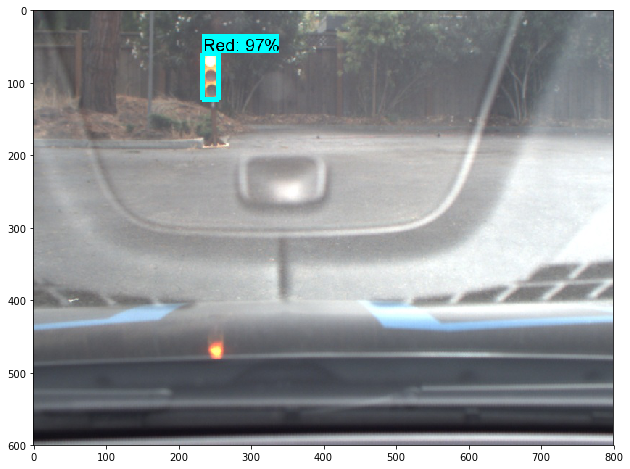

Time in ms:  82.22079277038574 



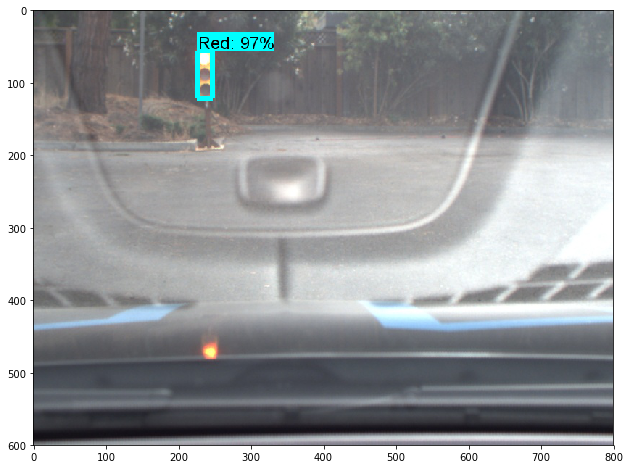

Time in ms:  84.22565460205078 



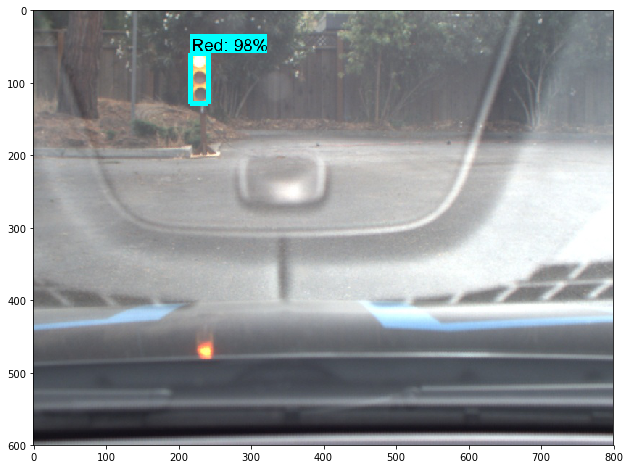

Time in ms:  80.2145004272461 



In [ ]:
# The time for the first image includes startup time for tensorflow
with detection_graph.as_default():
  with tf.Session(graph=detection_graph) as sess:
    # Definite input and output Tensors for detection_graph
    image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
    # Each box represents a part of the image where a particular object was detected.
    detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
    # Each score represent how level of confidence for each of the objects.
    # Score is shown on the result image, together with the class label.
    detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
    detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
    num_detections = detection_graph.get_tensor_by_name('num_detections:0')
    for image_path in TEST_IMAGE_PATHS:
      image = Image.open(image_path)
      # the array based representation of the image will be used later in order to prepare the
      # result image with boxes and labels on it.
      image_np = load_image_into_numpy_array(image)
      # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
      image_np_expanded = np.expand_dims(image_np, axis=0)
        
      # Actual detection.
      time0 = time.time()
      (boxes, scores, classes, num) = sess.run(
          [detection_boxes, detection_scores, detection_classes, num_detections],
          feed_dict={image_tensor: image_np_expanded})
      time1 = time.time()
        
      # Visualization of the results of a detection.
      vis_util.visualize_boxes_and_labels_on_image_array(
          image_np,
          np.squeeze(boxes),
          np.squeeze(classes).astype(np.int32),
          np.squeeze(scores),
          category_index,
          use_normalized_coordinates=True,
          line_thickness=7)
      plt.figure(figsize=IMAGE_SIZE)
      plt.rcParams.update({'figure.max_open_warning': 0})
      plt.imshow(image_np)
      plt.show()
      print("Time in ms: ", (time1 - time0) * 1000, "\n")